# Artificial Intelligence Nanodegree

## Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the iPython Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this IPython notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Use a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 6](#step6): Write your Algorithm
* [Step 7](#step7): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

### Import Dog Dataset

In the code cell below, we import a dataset of dog images.  We populate a few variables through the use of the `load_files` function from the scikit-learn library:
- `train_files`, `valid_files`, `test_files` - numpy arrays containing file paths to images
- `train_targets`, `valid_targets`, `test_targets` - numpy arrays containing onehot-encoded classification labels 
- `dog_names` - list of string-valued dog breed names for translating labels

In [1]:
import tensorflow as tf
from keras.backend.tensorflow_backend import set_session
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.5
set_session(tf.Session(config=config))

Using TensorFlow backend.


In [2]:
from sklearn.datasets import load_files       
from keras.utils import np_utils
import numpy as np
from glob import glob

# define function to load train, test, and validation datasets
def load_dataset(path):
    data = load_files(path)
    dog_files = np.array(data['filenames'])
    dog_targets = np_utils.to_categorical(np.array(data['target']), 133)
    return dog_files, dog_targets

# load train, test, and validation datasets
train_files, train_targets = load_dataset('dogImages/train')
valid_files, valid_targets = load_dataset('dogImages/valid')
test_files, test_targets = load_dataset('dogImages/test')

# load list of dog names
dog_names = [item[20:-1] for item in sorted(glob("dogImages/train/*/"))]

# print statistics about the dataset
print('There are %d total dog categories.' % len(dog_names))
print('There are %s total dog images.\n' % len(np.hstack([train_files, valid_files, test_files])))
print('There are %d training dog images.' % len(train_files))
print('There are %d validation dog images.' % len(valid_files))
print('There are %d test dog images.'% len(test_files))

There are 133 total dog categories.
There are 8351 total dog images.

There are 6680 training dog images.
There are 835 validation dog images.
There are 836 test dog images.


### Import Human Dataset

In the code cell below, we import a dataset of human images, where the file paths are stored in the numpy array `human_files`.

In [3]:
import random
random.seed(8675309)

# load filenames in shuffled human dataset
human_files = np.array(glob("lfw/*/*"))
random.shuffle(human_files)

# print statistics about the dataset
print('There are %d total human images.' % len(human_files))

There are 13233 total human images.


---
<a id='step1'></a>
## Step 1: Detect Humans

We use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.

In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


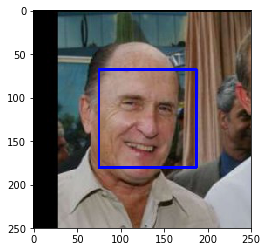

In [4]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[3])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [5]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 

In [6]:
human_files_short = human_files[:100]
dog_files_short = train_files[:100]
# Do NOT modify the code above this line.

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.
def detector_pct(detector, paths):
    return np.sum(list(map(detector, paths)))
print('A total of %d%% of images have detected a human face in the human_files_short.' % detector_pct(face_detector, human_files_short))
print('A total of %d%% of images have detected a human face in the dog_files_short.' % detector_pct(face_detector, dog_files_short))

A total of 100% of images have detected a human face in the human_files_short.
A total of 11% of images have detected a human face in the dog_files_short.


__Question 2:__ This algorithmic choice necessitates that we communicate to the user that we accept human images only when they provide a clear view of a face (otherwise, we risk having unneccessarily frustrated users!). In your opinion, is this a reasonable expectation to pose on the user? If not, can you think of a way to detect humans in images that does not necessitate an image with a clearly presented face?

__Answer:__ For this application, it is a reasonable expectation to impose.  When evaluating resembling breeds, facial resemblence provides quite a bit of entertainment.  Evaluating on other features, such as body type, less so.  Given a corpus of labeled images, some of which are labeled as human, we could use transfer learning on one of the ImageNet trained-models.

We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on each of the datasets.

In [7]:
## (Optional) TODO: Report the performance of another  
## face detection algorithm on the LFW dataset
### Feel free to use as many code cells as needed.

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a pre-trained [ResNet-50](http://ethereon.github.io/netscope/#/gist/db945b393d40bfa26006) model to detect dogs in images.  Our first line of code downloads the ResNet-50 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  Given an image, this pre-trained ResNet-50 model returns a prediction (derived from the available categories in ImageNet) for the object that is contained in the image.

In [8]:
from keras.applications.resnet50 import ResNet50

# define ResNet50 model
ResNet50_model = ResNet50(weights='imagenet')

Instructions for updating:
keep_dims is deprecated, use keepdims instead


### Pre-process the Data

When using TensorFlow as backend, Keras CNNs require a 4D array (which we'll also refer to as a 4D tensor) as input, with shape

$$
(\text{nb_samples}, \text{rows}, \text{columns}, \text{channels}),
$$

where `nb_samples` corresponds to the total number of images (or samples), and `rows`, `columns`, and `channels` correspond to the number of rows, columns, and channels for each image, respectively.  

The `path_to_tensor` function below takes a string-valued file path to a color image as input and returns a 4D tensor suitable for supplying to a Keras CNN.  The function first loads the image and resizes it to a square image that is $224 \times 224$ pixels.  Next, the image is converted to an array, which is then resized to a 4D tensor.  In this case, since we are working with color images, each image has three channels.  Likewise, since we are processing a single image (or sample), the returned tensor will always have shape

$$
(1, 224, 224, 3).
$$

The `paths_to_tensor` function takes a numpy array of string-valued image paths as input and returns a 4D tensor with shape 

$$
(\text{nb_samples}, 224, 224, 3).
$$

Here, `nb_samples` is the number of samples, or number of images, in the supplied array of image paths.  It is best to think of `nb_samples` as the number of 3D tensors (where each 3D tensor corresponds to a different image) in your dataset!

In [9]:
from keras.preprocessing import image                  
from tqdm import tqdm

def path_to_tensor(img_path):
    # loads RGB image as PIL.Image.Image type
    img = image.load_img(img_path, target_size=(224, 224))
    # convert PIL.Image.Image type to 3D tensor with shape (224, 224, 3)
    x = image.img_to_array(img)
    # convert 3D tensor to 4D tensor with shape (1, 224, 224, 3) and return 4D tensor
    return np.expand_dims(x, axis=0)

def paths_to_tensor(img_paths):
    list_of_tensors = [path_to_tensor(img_path) for img_path in tqdm(img_paths)]
    return np.vstack(list_of_tensors)

### Making Predictions with ResNet-50

Getting the 4D tensor ready for ResNet-50, and for any other pre-trained model in Keras, requires some additional processing.  First, the RGB image is converted to BGR by reordering the channels.  All pre-trained models have the additional normalization step that the mean pixel (expressed in RGB as $[103.939, 116.779, 123.68]$ and calculated from all pixels in all images in ImageNet) must be subtracted from every pixel in each image.  This is implemented in the imported function `preprocess_input`.  If you're curious, you can check the code for `preprocess_input` [here](https://github.com/fchollet/keras/blob/master/keras/applications/imagenet_utils.py).

Now that we have a way to format our image for supplying to ResNet-50, we are now ready to use the model to extract the predictions.  This is accomplished with the `predict` method, which returns an array whose $i$-th entry is the model's predicted probability that the image belongs to the $i$-th ImageNet category.  This is implemented in the `ResNet50_predict_labels` function below.

By taking the argmax of the predicted probability vector, we obtain an integer corresponding to the model's predicted object class, which we can identify with an object category through the use of this [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a). 

In [10]:
from keras.applications.resnet50 import preprocess_input, decode_predictions

def ResNet50_predict_labels(img_path):
    # returns prediction vector for image located at img_path
    img = preprocess_input(path_to_tensor(img_path))
    return np.argmax(ResNet50_model.predict(img))

### Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained ResNet-50 model, we need only check if the `ResNet50_predict_labels` function above returns a value between 151 and 268 (inclusive).

We use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [11]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    prediction = ResNet50_predict_labels(img_path)
    return ((prediction <= 268) & (prediction >= 151)) 

### (IMPLEMENTATION) Assess the Dog Detector

__Question 3:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 

In [12]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
print('A total of %d%% images have detected a dog in the human_files_short.' % detector_pct(dog_detector, human_files_short))
print('A total of %d%% images have detected a dog in the dog_files_short.' % detector_pct(dog_detector, dog_files_short))

A total of 0% images have detected a dog in the human_files_short.
A total of 100% images have detected a dog in the dog_files_short.


---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 1%.  In Step 5 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

Be careful with adding too many trainable layers!  More parameters means longer training, which means you are more likely to need a GPU to accelerate the training process.  Thankfully, Keras provides a handy estimate of the time that each epoch is likely to take; you can extrapolate this estimate to figure out how long it will take for your algorithm to train. 

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have great difficulty in distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun! 

### Pre-process the Data

We rescale the images by dividing every pixel in every image by 255.

In [20]:
from PIL import ImageFile                            
ImageFile.LOAD_TRUNCATED_IMAGES = True                 

# pre-process the data for Keras
train_tensors = paths_to_tensor(train_files).astype('float32')/255
valid_tensors = paths_to_tensor(valid_files).astype('float32')/255
test_tensors = paths_to_tensor(test_files).astype('float32')/255

100%|██████████| 836/836 [00:10<00:00, 96.04it/s] 


### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  At the end of your code cell block, summarize the layers of your model by executing the line:
    
        model.summary()

We have imported some Python modules to get you started, but feel free to import as many modules as you need.  If you end up getting stuck, here's a hint that specifies a model that trains relatively fast on CPU and attains >1% test accuracy in 5 epochs:

![Sample CNN](images/sample_cnn.png)
           
__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  If you chose to use the hinted architecture above, describe why you think that CNN architecture should work well for the image classification task.

__Answer:__ The architecture below is similar to VGG, with repeated convolutional layers that have ReLU activation and batch normalization.  Each block uses max pooling.  The blocks are repeated until 128 filters are constructed.  Going beyond 128 seemed to lead to overfitting.  An intermediate dense layer (with ReLU activation) was used based on the learnings below (in the transfer learning section).

In [22]:
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D
from keras.layers import Dropout, Flatten, Dense, BatchNormalization, Input, Activation
import keras.layers as layers
from keras.models import Sequential

model = Sequential()

model.add(Conv2D(16, (3,3), activation='relu', input_shape=(224,224,3)))
model.add(BatchNormalization())
model.add(Conv2D(16, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(16, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(32, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(32, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(32, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(64, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(64, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(64, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(128, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(128, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(128, (3,3), activation='relu'))
model.add(BatchNormalization())
model.add(GlobalAveragePooling2D())
model.add(Dense(500,activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(133,activation="softmax"))

model.summary()

Instructions for updating:
keep_dims is deprecated, use keepdims instead
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 222, 222, 16)      448       
_________________________________________________________________
batch_normalization_1 (Batch (None, 222, 222, 16)      64        
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 220, 220, 16)      2320      
_________________________________________________________________
batch_normalization_2 (Batch (None, 220, 220, 16)      64        
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 218, 218, 16)      2320      
_________________________________________________________________
batch_normalization_3 (Batch (None, 218, 218, 16)      64        
_________________________________________________________________
max

###### Compile the Model

In [23]:
model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['accuracy'])

Instructions for updating:
keep_dims is deprecated, use keepdims instead


### (IMPLEMENTATION) Train the Model

Train your model in the code cell below.  Use model checkpointing to save the model that attains the best validation loss.

You are welcome to [augment the training data](https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html), but this is not a requirement. 

In [24]:
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

epochs = 200

checkpointer = ModelCheckpoint(filepath='saved_models/weights.best.from_scratch.hdf5', 
                               verbose=1, save_best_only=True)

early_stopper = EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=20,
    verbose=0,
    mode='auto')

# Switched code to generator to allow for data augmentation.
model.fit_generator(
    train_datagen.flow(train_tensors, train_targets, batch_size=80), 
    validation_data=(valid_tensors, valid_targets),
    epochs=epochs, steps_per_epoch=len(train_targets)//80, 
    callbacks=[checkpointer, early_stopper], verbose=1)

Epoch 1/200
83/83 [==============================] - 50s - loss: 4.7483 - acc: 0.0279 - val_loss: 6.1291 - val_acc: 0.0084
Epoch 2/200
83/83 [==============================] - 45s - loss: 4.3702 - acc: 0.0479 - val_loss: 9.7384 - val_acc: 0.0108
Epoch 3/200
83/83 [==============================] - 45s - loss: 4.1012 - acc: 0.0691 - val_loss: 7.4126 - val_acc: 0.0096
Epoch 4/200
83/83 [==============================] - 45s - loss: 3.9017 - acc: 0.0869 - val_loss: 5.5626 - val_acc: 0.0228
Epoch 5/200
83/83 [==============================] - 45s - loss: 3.7649 - acc: 0.1042 - val_loss: 4.4268 - val_acc: 0.0623
Epoch 6/200
83/83 [==============================] - 45s - loss: 3.6154 - acc: 0.1208 - val_loss: 4.2068 - val_acc: 0.0766
Epoch 7/200
83/83 [==============================] - 45s - loss: 3.4890 - acc: 0.1416 - val_loss: 4.1088 - val_acc: 0.0743
Epoch 8/200
83/83 [==============================] - 45s - loss: 3.3816 - acc: 0.1620 - val_loss: 3.6349 - val_acc: 0.1341
Epoch 9/200
83/8

### Load the Model with the Best Validation Loss

In [25]:
model.load_weights('saved_models/weights.best.from_scratch.hdf5')

### Test the Model

Try out your model on the test dataset of dog images.  Ensure that your test accuracy is greater than 1%.

In [26]:
# get index of predicted dog breed for each image in test set
dog_breed_predictions = [np.argmax(model.predict(np.expand_dims(tensor, axis=0))) for tensor in test_tensors]

# report test accuracy
test_accuracy = 100*np.sum(np.array(dog_breed_predictions)==np.argmax(test_targets, axis=1))/len(dog_breed_predictions)
print('Test accuracy: %.4f%%' % test_accuracy)

Test accuracy: 56.5789%


---
<a id='step4'></a>
## Step 4: Use a CNN to Classify Dog Breeds

To reduce training time without sacrificing accuracy, we show you how to train a CNN using transfer learning.  In the following step, you will get a chance to use transfer learning to train your own CNN.

### Obtain Bottleneck Features

In [27]:
bottleneck_features = np.load('bottleneck_features/DogVGG16Data.npz')
train_VGG16 = bottleneck_features['train']
valid_VGG16 = bottleneck_features['valid']
test_VGG16 = bottleneck_features['test']

### Model Architecture

The model uses the the pre-trained VGG-16 model as a fixed feature extractor, where the last convolutional output of VGG-16 is fed as input to our model.  We only add a global average pooling layer and a fully connected layer, where the latter contains one node for each dog category and is equipped with a softmax.

In [28]:
VGG16_model = Sequential()
VGG16_model.add(GlobalAveragePooling2D(input_shape=train_VGG16.shape[1:]))
VGG16_model.add(Dense(133, activation='softmax'))

VGG16_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
global_average_pooling2d_2 ( (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 133)               68229     
Total params: 68,229.0
Trainable params: 68,229.0
Non-trainable params: 0.0
_________________________________________________________________


### Compile the Model

In [29]:
VGG16_model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

### Train the Model

In [30]:
checkpointer = ModelCheckpoint(filepath='saved_models/weights.best.VGG16.hdf5', 
                               verbose=1, save_best_only=True)

VGG16_model.fit(train_VGG16, train_targets, 
          validation_data=(valid_VGG16, valid_targets),
          epochs=20, batch_size=20, callbacks=[checkpointer], verbose=1)

Train on 6680 samples, validate on 835 samples
Epoch 1/20
6680/6680 [==============================] - 1s - loss: 12.8147 - acc: 0.0993 - val_loss: 11.3596 - val_acc: 0.1844
Epoch 2/20
6680/6680 [==============================] - 1s - loss: 10.5847 - acc: 0.2446 - val_loss: 10.5428 - val_acc: 0.2491
Epoch 3/20
6680/6680 [==============================] - 1s - loss: 9.9177 - acc: 0.3133 - val_loss: 10.2203 - val_acc: 0.2802
Epoch 4/20
6680/6680 [==============================] - 1s - loss: 9.5839 - acc: 0.3503 - val_loss: 9.8977 - val_acc: 0.3198
Epoch 5/20
6680/6680 [==============================] - 1s - loss: 9.2928 - acc: 0.3801 - val_loss: 9.7290 - val_acc: 0.3281
Epoch 6/20
6680/6680 [==============================] - 1s - loss: 8.9997 - acc: 0.4046 - val_loss: 9.5702 - val_acc: 0.3329
Epoch 7/20
6680/6680 [==============================] - 1s - loss: 8.7776 - acc: 0.4253 - val_loss: 9.4669 - val_acc: 0.3341
Epoch 8/20
6680/6680 [==============================] - 1s - loss: 8.6592

### Load the Model with the Best Validation Loss

In [31]:
VGG16_model.load_weights('saved_models/weights.best.VGG16.hdf5')

### Test the Model

Now, we can use the CNN to test how well it identifies breed within our test dataset of dog images.  We print the test accuracy below.

In [32]:
# get index of predicted dog breed for each image in test set
VGG16_predictions = [np.argmax(VGG16_model.predict(np.expand_dims(feature, axis=0))) for feature in test_VGG16]

# report test accuracy
test_accuracy = 100*np.sum(np.array(VGG16_predictions)==np.argmax(test_targets, axis=1))/len(VGG16_predictions)
print('Test accuracy: %.4f%%' % test_accuracy)

Test accuracy: 40.1914%


### Predict Dog Breed with the Model

In [23]:
from extract_bottleneck_features import *

def VGG16_predict_breed(img_path):
    # extract bottleneck features
    bottleneck_feature = extract_VGG16(path_to_tensor(img_path))
    # obtain predicted vector
    predicted_vector = VGG16_model.predict(bottleneck_feature)
    # return dog breed that is predicted by the model
    return dog_names[np.argmax(predicted_vector)]

---
<a id='step5'></a>
## Step 5: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

In Step 4, we used transfer learning to create a CNN using VGG-16 bottleneck features.  In this section, you must use the bottleneck features from a different pre-trained model.  To make things easier for you, we have pre-computed the features for all of the networks that are currently available in Keras:
- [VGG-19](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogVGG19Data.npz) bottleneck features
- [ResNet-50](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogResnet50Data.npz) bottleneck features
- [Inception](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogInceptionV3Data.npz) bottleneck features
- [Xception](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogXceptionData.npz) bottleneck features

The files are encoded as such:

    Dog{network}Data.npz
    
where `{network}`, in the above filename, can be one of `VGG19`, `Resnet50`, `InceptionV3`, or `Xception`.  Pick one of the above architectures, download the corresponding bottleneck features, and store the downloaded file in the `bottleneck_features/` folder in the repository.

### (IMPLEMENTATION) Obtain Bottleneck Features

In the code block below, extract the bottleneck features corresponding to the train, test, and validation sets by running the following:

    bottleneck_features = np.load('bottleneck_features/Dog{network}Data.npz')
    train_{network} = bottleneck_features['train']
    valid_{network} = bottleneck_features['valid']
    test_{network} = bottleneck_features['test']

In [13]:
bottom_model_name = 'Xception'

if bottom_model_name == 'Resnet50': 
    bottleneck_features = np.load('bottleneck_features/DogResnet50Data.npz')
    train_Resnet50 = bottleneck_features['train']
    valid_Resnet50 = bottleneck_features['valid']
    test_Resnet50 = bottleneck_features['test']
elif bottom_model_name == 'VGG19':
    bottleneck_features = np.load('bottleneck_features/DogVGG19Data.npz')
    train_VGG19 = bottleneck_features['train']
    valid_VGG19 = bottleneck_features['valid']
    test_VGG19 = bottleneck_features['test']
elif bottom_model_name == 'InceptionV3':
    bottleneck_features = np.load('bottleneck_features/DogInceptionV3Data.npz')
    train_InceptionV3 = bottleneck_features['train']
    valid_InceptionV3 = bottleneck_features['valid']
    test_InceptionV3 = bottleneck_features['test']
else:
    bottleneck_features = np.load('bottleneck_features/DogXceptionData.npz')
    train_Xception = bottleneck_features['train']
    valid_Xception = bottleneck_features['valid']
    test_Xception = bottleneck_features['test']

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  At the end of your code cell block, summarize the layers of your model by executing the line:
    
        <your model's name>.summary()
   
__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 

In general, we have a relative small data set trained on similar data to that ImageNet.  In Step 3, a VGG-like architecture yielded 56.5789% on test accuracy, but was not able to generalize beyond this.  It is plausable that models trained on the larger ImageNet data set are picking up on more general features of the problem and those can be used to push accuracy beyond that level.  In Step 4, VGG16 was used as a base model with its classification layer being replaced by a single densely connected layer, achieving 40.1914% test accuracy.  As seen in the table below with VGG19, adding an additional densely connected layer between the GAP layer and the output would likely increase test accuracy.


In this setup, appending the first layer in the sequence, the GAP layer, dramatically reduced the number of parameters compared to a flatten layer.  For instance, adding a flatten layer to the InceptionV3 model resulted in millions of parameters.  Training a model using a flatten layer followed by the output layer resulted in very poor performance.

Given a GAP layer, the results using a single dense layer are given below.  Both _Resnet50_ and _InceptionV3_ seemed to be overfitting, whereas _VGG19_ seemed to be underfitting.

| Base Model |  Test Accuracy |
|---|---:|
| Resnet50 |  81.0% |
| VGG19 |  53.6% |
| InceptionV3 |  80.0% |
| Xception |   84.1% |

Adding a single dense, ReLU intermediate layer of size 200 with 50% dropout gives the following results:

| Base Model |  Test Accuracy |
|---|---:|
| Resnet50 |  80.02% |
| VGG19 |  70.3% |
| InceptionV3 |  78.7% |
| Xception |   81.9% |

The same intermediate layer except using batch normalization yields:

| Base Model |  Test Accuracy |
|---|---:|
| Resnet50 |  78.2% |
| VGG19 |  78.1% |
| InceptionV3 |  80.4% |
| Xception |   82.8% |

Given that the simpler models seem to be performing well, a _Xception_ base with a single dense output seems best.

In [14]:
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D
from keras.layers import Dropout, Flatten, Dense, BatchNormalization, Input, Activation
import keras.layers as layers
from keras.models import Sequential

top_model = Sequential()
if bottom_model_name == 'Resnet50':    
    top_model.add(GlobalAveragePooling2D(input_shape=train_Resnet50.shape[1:]))
elif bottom_model_name == 'VGG19':
    top_model.add(GlobalAveragePooling2D(input_shape=train_VGG19.shape[1:]))
elif bottom_model_name == 'InceptionV3':
    top_model.add(GlobalAveragePooling2D(input_shape=train_InceptionV3.shape[1:]))
else:
    top_model.add(GlobalAveragePooling2D(input_shape=train_Xception.shape[1:]))
    
top_model.add(Dense(133, activation='softmax'))
top_model.summary()

Instructions for updating:
keep_dims is deprecated, use keepdims instead
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
global_average_pooling2d_1 ( (None, 2048)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 133)               272517    
Total params: 272,517.0
Trainable params: 272,517.0
Non-trainable params: 0.0
_________________________________________________________________


### (IMPLEMENTATION) Compile the Model

In [16]:
top_model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

### (IMPLEMENTATION) Train the Model

Train your model in the code cell below.  Use model checkpointing to save the model that attains the best validation loss.  

You are welcome to [augment the training data](https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html), but this is not a requirement. 

In [19]:
if bottom_model_name == 'Resnet50':    
    train_top, valid_top, test_top = train_Resnet50, valid_Resnet50, test_Resnet50
elif bottom_model_name == 'VGG19':
    train_top, valid_top, test_top = train_VGG19, valid_VGG19, test_VGG19
elif bottom_model_name == 'InceptionV3':
    train_top, valid_top, test_top = train_InceptionV3, valid_InceptionV3, test_InceptionV3
else:
    train_top, valid_top, test_top = train_Xception, valid_Xception, test_Xception


In [146]:
from keras.callbacks import EarlyStopping 

checkpointer = ModelCheckpoint(filepath='saved_models/weights.best.top_model.hdf5', 
                               verbose=1, save_best_only=True)
 
early_stopper = EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=10,
    verbose=0,
    mode='auto')

top_model.fit(
    train_top,
    train_targets,
    validation_data=(valid_top, valid_targets),
    epochs=100, batch_size=20, callbacks=[checkpointer, early_stopper], verbose=1)

Train on 6680 samples, validate on 835 samples
Epoch 1/100
6680/6680 [==============================] - 5s - loss: 1.0594 - acc: 0.7352 - val_loss: 0.5244 - val_acc: 0.8192
Epoch 2/100
6680/6680 [==============================] - 3s - loss: 0.4017 - acc: 0.8707 - val_loss: 0.4852 - val_acc: 0.8443
Epoch 3/100
6680/6680 [==============================] - 3s - loss: 0.3247 - acc: 0.8988 - val_loss: 0.4680 - val_acc: 0.8551
Epoch 4/100
6680/6680 [==============================] - 3s - loss: 0.2742 - acc: 0.9115 - val_loss: 0.4669 - val_acc: 0.8575
Epoch 5/100
6680/6680 [==============================] - 3s - loss: 0.2395 - acc: 0.9244 - val_loss: 0.4955 - val_acc: 0.8611
Epoch 6/100
6680/6680 [==============================] - 3s - loss: 0.2125 - acc: 0.9344 - val_loss: 0.5157 - val_acc: 0.8539
Epoch 7/100
6680/6680 [==============================] - 3s - loss: 0.1913 - acc: 0.9391 - val_loss: 0.5121 - val_acc: 0.8551
Epoch 8/100
6680/6680 [==============================] - 3s - loss: 0.1

### (IMPLEMENTATION) Load the Model with the Best Validation Loss

In [20]:
top_model.load_weights('saved_models/weights.best.top_model.hdf5')

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Ensure that your test accuracy is greater than 60%.

In [21]:
### TODO: Calculate classification accuracy on the test dataset.
# get index of predicted dog breed for each image in test set

def main_prediction(features):
    return top_model.predict(np.expand_dims(features, axis=0))

top_model_probabilities = [main_prediction(feature) for feature in test_top]
top_model_predictions = [np.argmax(prob) for prob in top_model_probabilities]

# report test accuracy
test_accuracy = 100*np.sum(np.array(top_model_predictions)==np.argmax(test_targets, axis=1))/len(top_model_predictions)
print('Test accuracy: %.4f%%' % test_accuracy)

Test accuracy: 84.0909%


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan_hound`, etc) that is predicted by your model.  

Similar to the analogous function in Step 5, your function should have three steps:
1. Extract the bottleneck features corresponding to the chosen CNN model.
2. Supply the bottleneck features as input to the model to return the predicted vector.  Note that the argmax of this prediction vector gives the index of the predicted dog breed.
3. Use the `dog_names` array defined in Step 0 of this notebook to return the corresponding breed.

The functions to extract the bottleneck features can be found in `extract_bottleneck_features.py`, and they have been imported in an earlier code cell.  To obtain the bottleneck features corresponding to your chosen CNN architecture, you need to use the function

    extract_{network}
    
where `{network}`, in the above filename, should be one of `VGG19`, `Resnet50`, `InceptionV3`, or `Xception`.

In [24]:
if bottom_model_name == 'Resnet50':    
    extract_bottom_model = extract_Resnet50
elif bottom_model_name == 'VGG19':
    extract_bottom_model = extract_VGG19
elif bottom_model_name == 'InceptionV3':
    extract_bottom_model = extract_InceptionV3
else:
    extract_bottom_model = extract_Xception

def top_model_predict_breeds(img_path):
    # extract bottleneck features
    bottleneck_feature = extract_bottom_model(path_to_tensor(img_path))
    # obtain predicted vector
    predicted_vector = top_model.predict(bottleneck_feature)
    # return dog breed that is predicted by the model
    return list(zip(dog_names,predicted_vector[0]))

def top_model_predict_breed(img_path):
    # extract bottleneck features
    bottleneck_feature = extract_bottom_model(path_to_tensor(img_path))
    # obtain predicted vector
    predicted_vector = top_model.predict(bottleneck_feature)
    # return dog breed that is predicted by the model
    return dog_names[np.argmax(predicted_vector)]

---
<a id='step6'></a>
## Step 6: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `dog_detector` functions developed above.  You are __required__ to use your CNN from Step 5 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [25]:
from IPython.display import Image, display


def breed_classifer(path, prob_threshold=0.01, max_breeds=5):
    def plot_img(path):
        import matplotlib.image as mpimg
        img = mpimg.imread(path)
        plt.imshow(img)
        plt.show()
    possible_breads = sorted(
        top_model_predict_breeds(path), 
        key=lambda x: x[1], 
        reverse=True)
    
    print('----')
    plot_img(path)
    if dog_detector(path):
        print('Detection: Dog')
        print('Most likely breed:',top_model_predict_breed(path))
        print('Predictions:')
        for (name, prob) in possible_breads[:max_breeds]:
            if prob >= prob_threshold:
                print('   ', name, ' - ', prob)
    elif face_detector(path):
        print('Detection: Human')
        print('Resembling breed:',top_model_predict_breed(path))
        print('Resembling breeds with degree of resemblance:')
        for (name, prob) in possible_breads[:max_breeds]:
            if prob >= prob_threshold:
                print('   ', name, '-', prob)
    else:
        print('ERROR - No dog nor human detected')
    

---
<a id='step7'></a>
## Step 7: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that __you__ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ The algorithm seems to do reasonably well when there is a single dog centered in the image.  The prediction accuracy is better than that of the human judge (at least the author of the model) .

Points of improvement:
- Rather than returning a single prediction, return the image location and prediction.  This would allow for multiple dog-breed labels when there are multiple dogs in the image.
- Similarly, use a dog and human detector to find all of the dogs and humans in the image.
- In terms of modeling, rather than a single dense layer retrained on the dog image data, attempt-fine tuning the Xception model.  Perhaps some of the other features of the image, such as the size of nearby objects can help descriminate between similarly looking breeds of vastly different sizes.

----


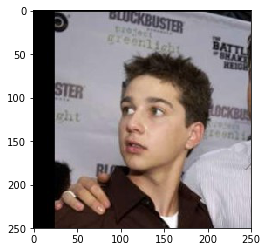

Detection: Human
Resembling breed: Anatolian_shepherd_dog
Resembling breeds with degree of resemblance:
    Anatolian_shepherd_dog - 0.0647276
    Icelandic_sheepdog - 0.0636764
    Bearded_collie - 0.0516697
    Canaan_dog - 0.0456671
    Lowchen - 0.0345379
----


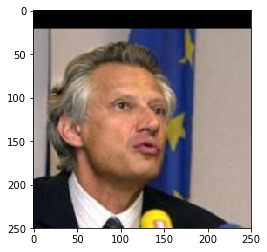

Detection: Human
Resembling breed: Petit_basset_griffon_vendeen
Resembling breeds with degree of resemblance:
    Petit_basset_griffon_vendeen - 0.0794686
    Cardigan_welsh_corgi - 0.0517559
    Chinese_crested - 0.0514251
    Portuguese_water_dog - 0.0513475
    Cavalier_king_charles_spaniel - 0.0391389
----


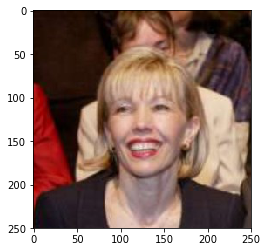

Detection: Human
Resembling breed: Dachshund
Resembling breeds with degree of resemblance:
    Dachshund - 0.111962
    Cardigan_welsh_corgi - 0.060653
    Bearded_collie - 0.046075
    Chinese_crested - 0.043887
    Curly-coated_retriever - 0.0438242
----


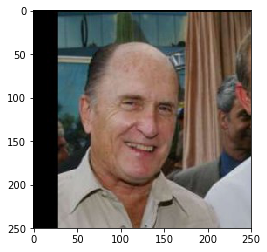

Detection: Human
Resembling breed: Dachshund
Resembling breeds with degree of resemblance:
    Dachshund - 0.193044
    Parson_russell_terrier - 0.0646293
    Smooth_fox_terrier - 0.0515739
    Cavalier_king_charles_spaniel - 0.0462049
    Lowchen - 0.034788
----


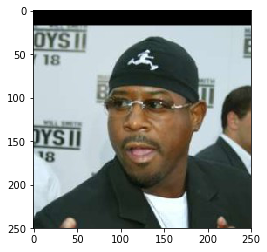

Detection: Human
Resembling breed: Belgian_tervuren
Resembling breeds with degree of resemblance:
    Belgian_tervuren - 0.10549
    German_shepherd_dog - 0.0393444
    Icelandic_sheepdog - 0.0389801
    Portuguese_water_dog - 0.0364428
    Dachshund - 0.0310758
----


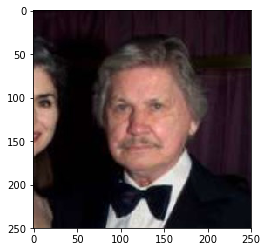

Detection: Human
Resembling breed: Old_english_sheepdog
Resembling breeds with degree of resemblance:
    Old_english_sheepdog - 0.0913349
    Cardigan_welsh_corgi - 0.0504099
    Cavalier_king_charles_spaniel - 0.0419377
    Pekingese - 0.0415815
    American_water_spaniel - 0.0408179
----


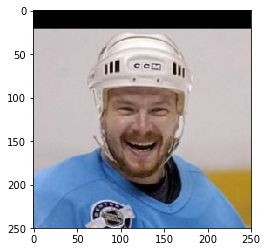

Detection: Human
Resembling breed: Dachshund
Resembling breeds with degree of resemblance:
    Dachshund - 0.283952
    Chinese_crested - 0.0631231
    Affenpinscher - 0.0596683
    German_wirehaired_pointer - 0.0368419
    Chesapeake_bay_retriever - 0.0296785
----


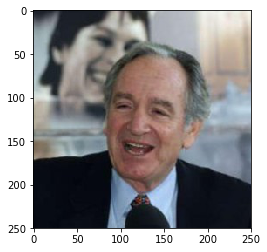

Detection: Human
Resembling breed: Lowchen
Resembling breeds with degree of resemblance:
    Lowchen - 0.102102
    Cardigan_welsh_corgi - 0.0832356
    Dachshund - 0.0826806
    Bearded_collie - 0.0675226
    Petit_basset_griffon_vendeen - 0.0517275
----


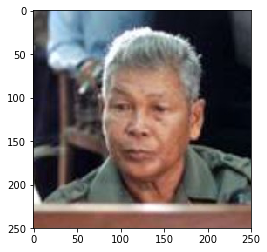

Detection: Human
Resembling breed: Cavalier_king_charles_spaniel
Resembling breeds with degree of resemblance:
    Cavalier_king_charles_spaniel - 0.181029
    Brussels_griffon - 0.0725721
    Dachshund - 0.0370236
    Smooth_fox_terrier - 0.0320564
    Affenpinscher - 0.0289282
----


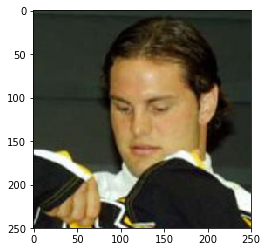

Detection: Human
Resembling breed: American_foxhound
Resembling breeds with degree of resemblance:
    American_foxhound - 0.229301
    Parson_russell_terrier - 0.108889
    Smooth_fox_terrier - 0.104022
    Dachshund - 0.061377
    Cardigan_welsh_corgi - 0.045256


In [26]:
for human_file in human_files_short[:10]:
    breed_classifer(human_file) 

----


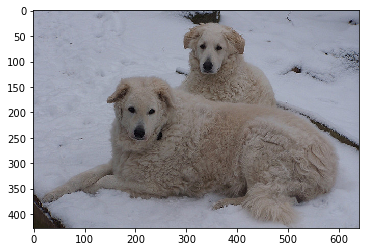

Detection: Dog
Most likely breed: Kuvasz
Predictions:
    Kuvasz  -  0.999821
----


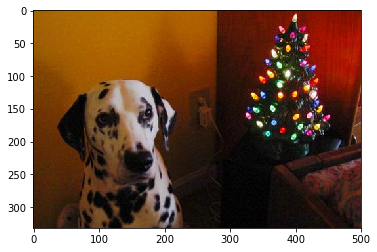

Detection: Dog
Most likely breed: Dalmatian
Predictions:
    Dalmatian  -  0.999932
----


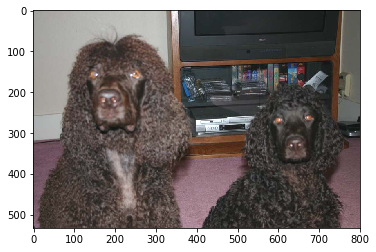

Detection: Dog
Most likely breed: Irish_water_spaniel
Predictions:
    Irish_water_spaniel  -  0.617007
    American_water_spaniel  -  0.355581
    Boykin_spaniel  -  0.0243317
----


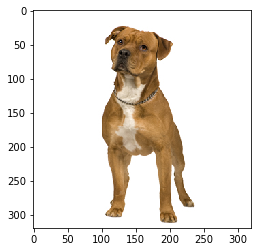

Detection: Dog
Most likely breed: American_staffordshire_terrier
Predictions:
    American_staffordshire_terrier  -  0.9759
----


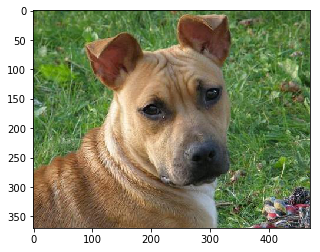

Detection: Dog
Most likely breed: American_staffordshire_terrier
Predictions:
    American_staffordshire_terrier  -  0.995732
----


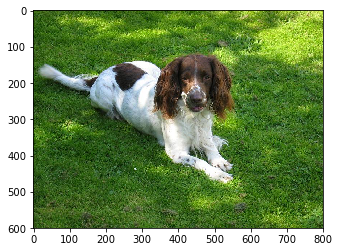

Detection: Dog
Most likely breed: English_springer_spaniel
Predictions:
    English_springer_spaniel  -  0.792189
    Welsh_springer_spaniel  -  0.153713
    Irish_red_and_white_setter  -  0.0371187
----


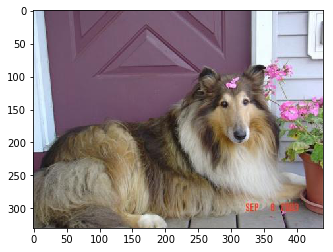

Detection: Dog
Most likely breed: Collie
Predictions:
    Collie  -  0.999997
----


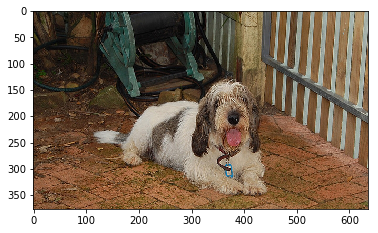

Detection: Dog
Most likely breed: Petit_basset_griffon_vendeen
Predictions:
    Petit_basset_griffon_vendeen  -  0.999408
----


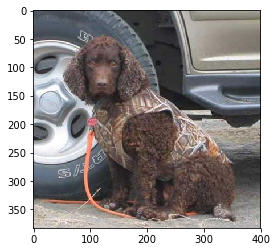

Detection: Dog
Most likely breed: American_water_spaniel
Predictions:
    American_water_spaniel  -  0.999755
----


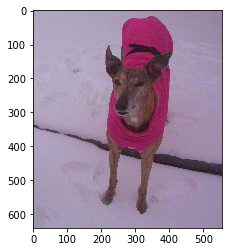

Detection: Dog
Most likely breed: Greyhound
Predictions:
    Greyhound  -  0.84292
    Xoloitzcuintli  -  0.0741859
    German_pinscher  -  0.045238


In [27]:
for dog_file in dog_files_short[:10]:
    breed_classifer(dog_file)

### Diagnostics


----
Correct answer:  Belgian_sheepdog
Predicted: 
    Belgian_sheepdog :  0.0511055
    Boykin_spaniel :  0.0160016
    Cairn_terrier :  0.0168693
    Cane_corso :  0.0294597
    Flat-coated_retriever :  0.0280457
    Giant_schnauzer :  0.828949


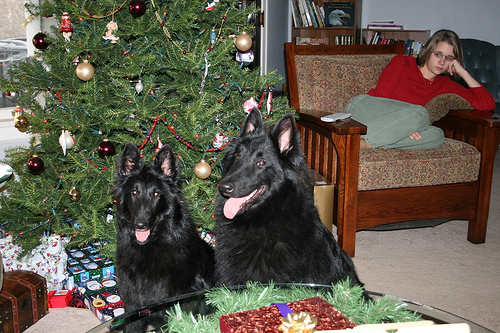

----
Correct answer:  Glen_of_imaal_terrier
Predicted: 
    Briard :  0.0106079
    Cairn_terrier :  0.0145445
    Dandie_dinmont_terrier :  0.0250031
    Glen_of_imaal_terrier :  0.0731384
    Golden_retriever :  0.101517
    Great_pyrenees :  0.0332041
    Havanese :  0.229074
    Lhasa_apso :  0.0506897
    Norfolk_terrier :  0.276268
    Otterhound :  0.0233105
    Petit_basset_griffon_vendeen :  0.141324


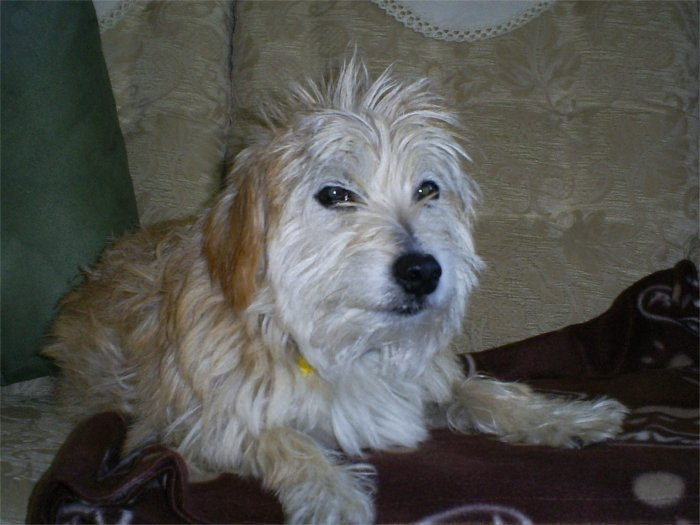

----
Correct answer:  Dachshund
Predicted: 
    Irish_wolfhound :  0.975951


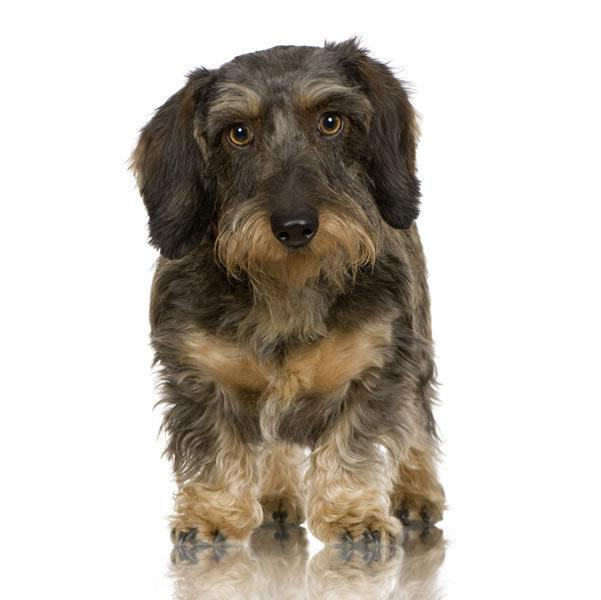

----
Correct answer:  Portuguese_water_dog
Predicted: 
    Poodle :  0.978266


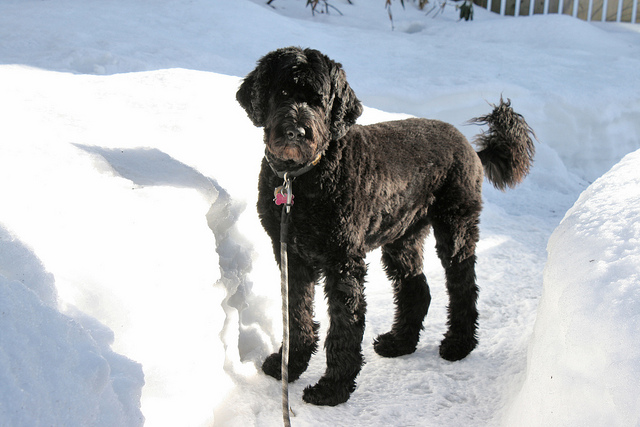

----
Correct answer:  Newfoundland
Predicted: 
    Chow_chow :  0.821708
    Newfoundland :  0.177011


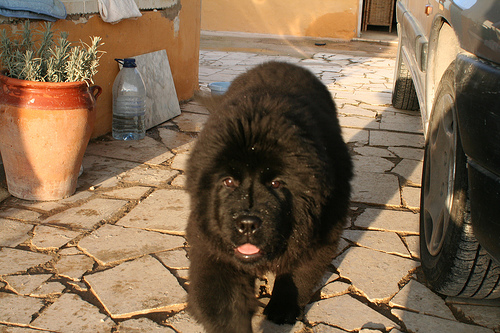

----
Correct answer:  Greyhound
Predicted: 
    Black_and_tan_coonhound :  0.0115188
    Doberman_pinscher :  0.173928
    German_pinscher :  0.0980965
    Greyhound :  0.1686
    Manchester_terrier :  0.0240778
    Plott :  0.505767


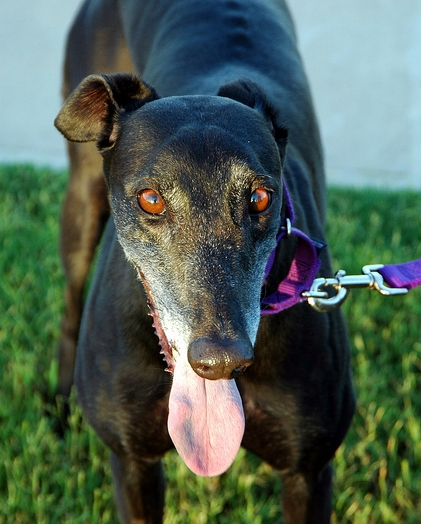

----
Correct answer:  English_cocker_spaniel
Predicted: 
    Boykin_spaniel :  0.837421
    Field_spaniel :  0.144904


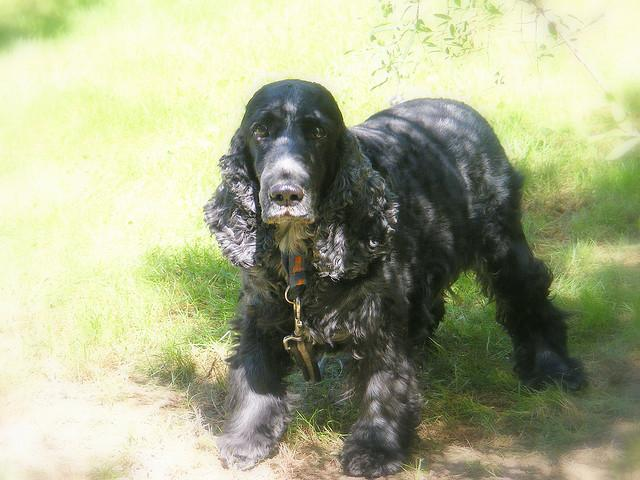

----
Correct answer:  Finnish_spitz
Predicted: 
    Finnish_spitz :  0.354317
    Icelandic_sheepdog :  0.0623095
    Norwegian_buhund :  0.567625


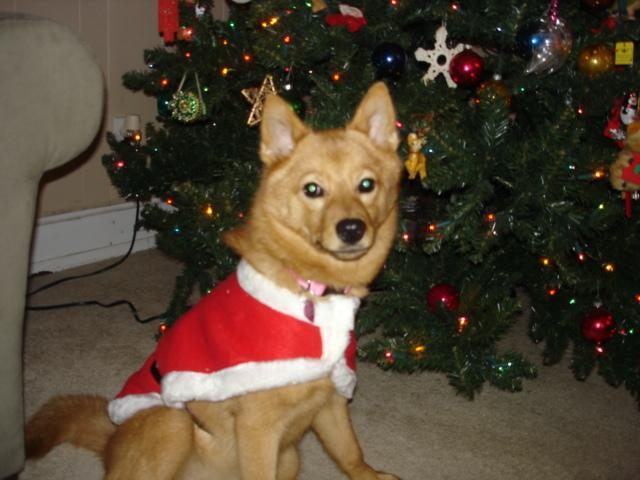

----
Correct answer:  Bouvier_des_flandres
Predicted: 
    Black_russian_terrier :  0.300547
    Bouvier_des_flandres :  0.231851
    Giant_schnauzer :  0.459973


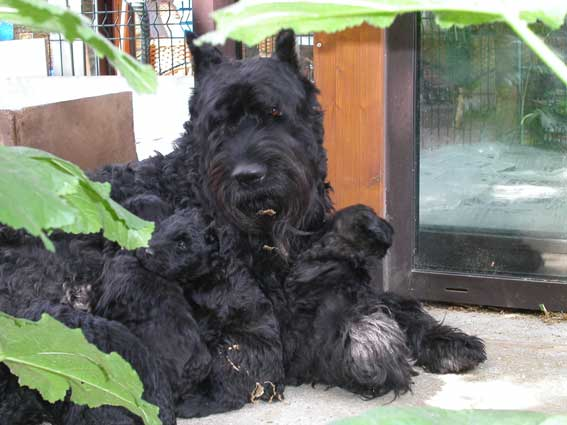

----
Correct answer:  Lakeland_terrier
Predicted: 
    Airedale_terrier :  0.800867
    Irish_terrier :  0.196966


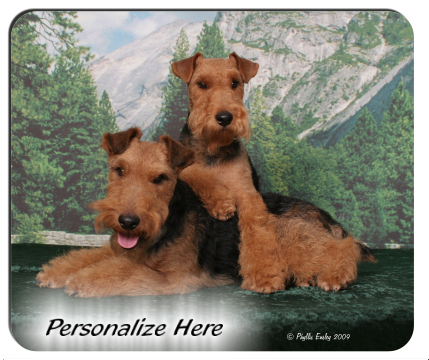

----
Correct answer:  Australian_cattle_dog
Predicted: 
    Australian_cattle_dog :  0.339028
    Belgian_malinois :  0.0184132
    Canaan_dog :  0.607494
    Finnish_spitz :  0.0105974


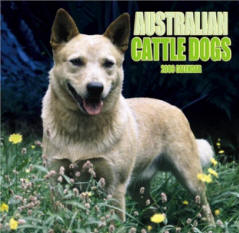

----
Correct answer:  Lowchen
Predicted: 
    Havanese :  0.638467
    Lhasa_apso :  0.176113
    Lowchen :  0.176885


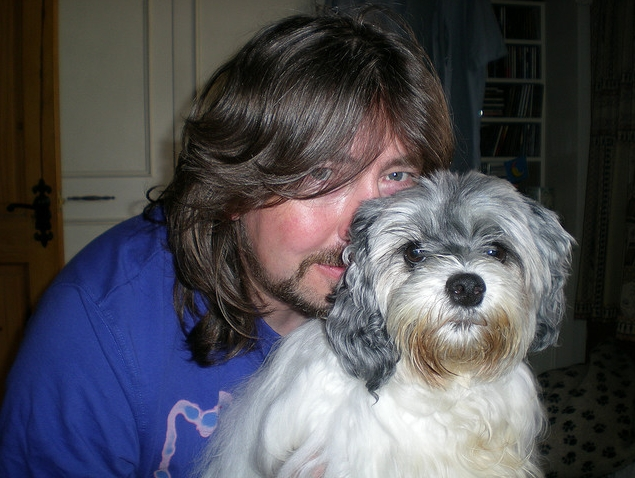

----
Correct answer:  Pointer
Predicted: 
    Chesapeake_bay_retriever :  0.0183643
    Dachshund :  0.0437321
    German_shorthaired_pointer :  0.633818
    German_wirehaired_pointer :  0.0172086
    Great_dane :  0.0155909
    Labrador_retriever :  0.101351
    Pointer :  0.148343


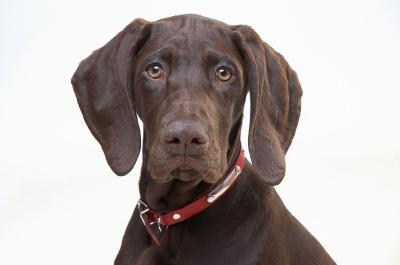

----
Correct answer:  German_shepherd_dog
Predicted: 
    German_shepherd_dog :  0.0184623
    Norwegian_elkhound :  0.981264


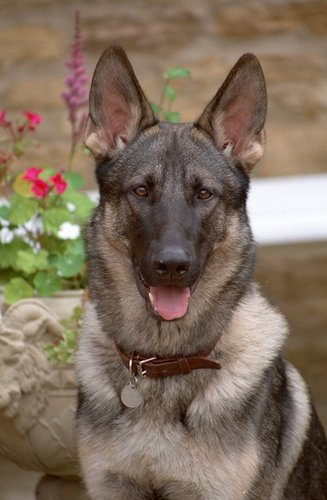

----
Correct answer:  English_cocker_spaniel
Predicted: 
    American_water_spaniel :  0.0147521
    Boykin_spaniel :  0.553561
    Cocker_spaniel :  0.144931
    English_cocker_spaniel :  0.0221654
    English_toy_spaniel :  0.0223789
    Gordon_setter :  0.229699


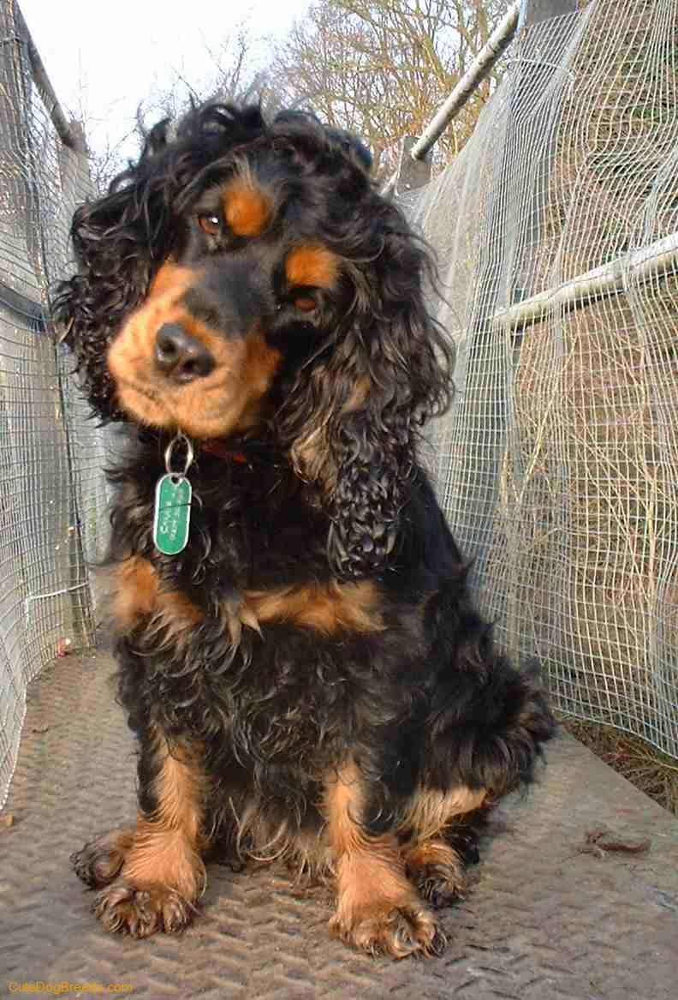

----
Correct answer:  Smooth_fox_terrier
Predicted: 
    Parson_russell_terrier :  0.773287
    Smooth_fox_terrier :  0.221877


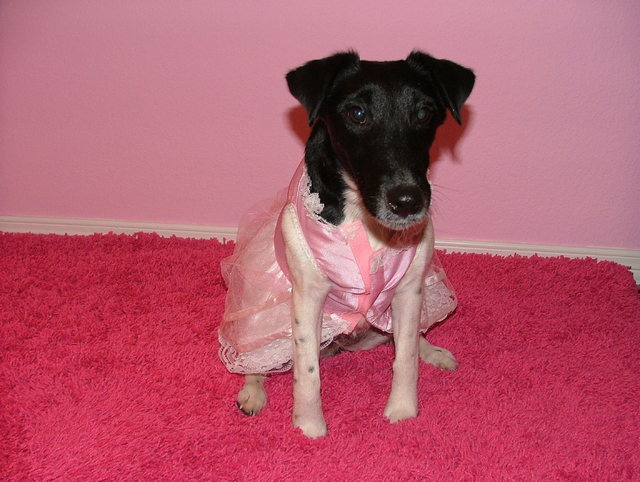

----
Correct answer:  Havanese
Predicted: 
    Bearded_collie :  0.600415
    Havanese :  0.290046
    Lowchen :  0.103607


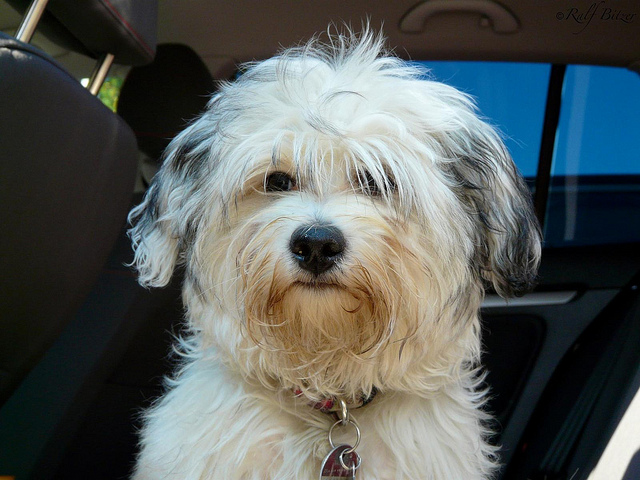

----
Correct answer:  Tibetan_mastiff
Predicted: 
    Golden_retriever :  0.866437
    Great_pyrenees :  0.0132247
    Nova_scotia_duck_tolling_retriever :  0.0533401
    Tibetan_mastiff :  0.056995


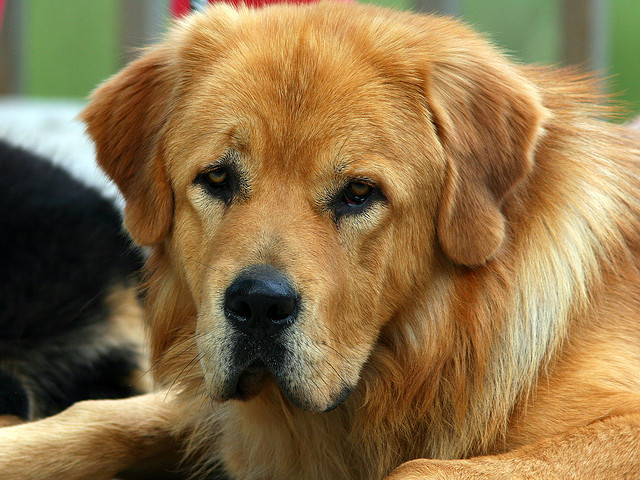

----
Correct answer:  German_pinscher
Predicted: 
    Doberman_pinscher :  0.836392
    German_pinscher :  0.15798


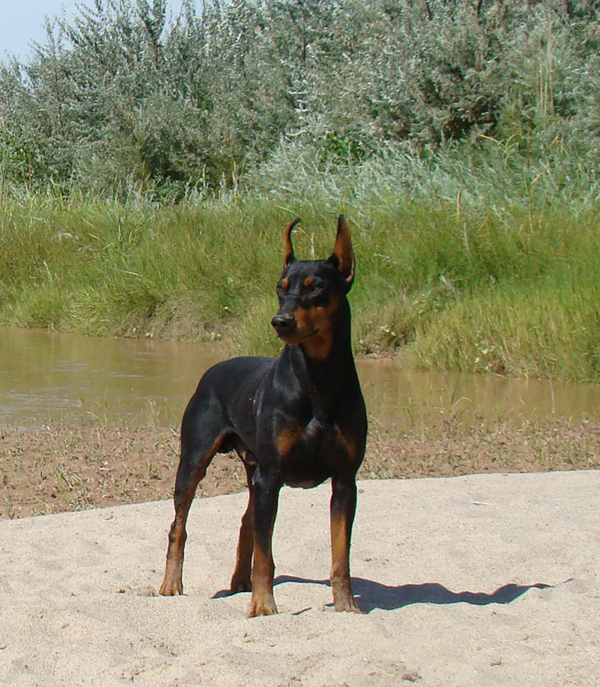

----
Correct answer:  Boykin_spaniel
Predicted: 
    American_water_spaniel :  0.523373
    Boykin_spaniel :  0.476591


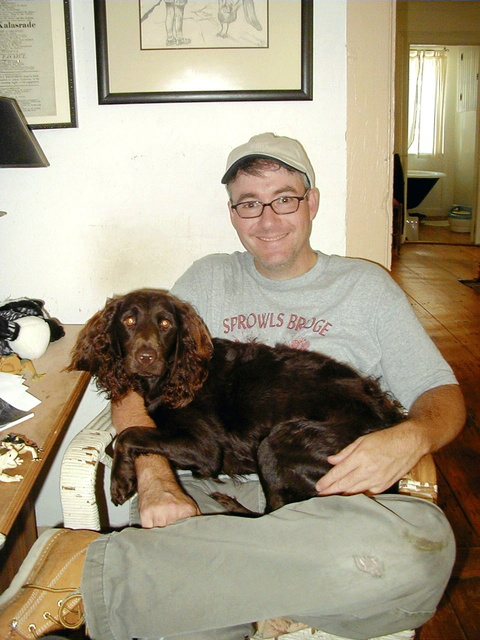

----
Correct answer:  Norwegian_elkhound
Predicted: 
    Akita :  0.0429612
    Finnish_spitz :  0.0195965
    Icelandic_sheepdog :  0.820837
    Norwegian_elkhound :  0.101958


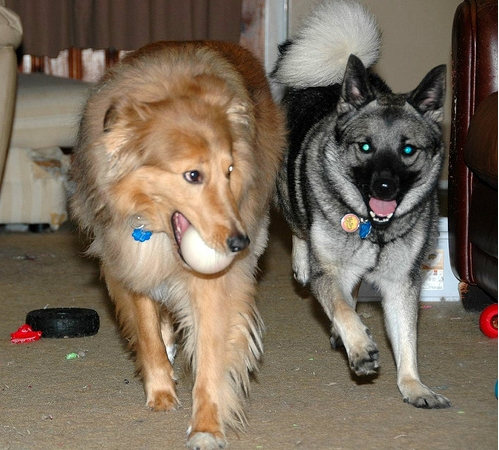

----
Correct answer:  Icelandic_sheepdog
Predicted: 
    Icelandic_sheepdog :  0.239613
    Papillon :  0.0167
    Pomeranian :  0.737243


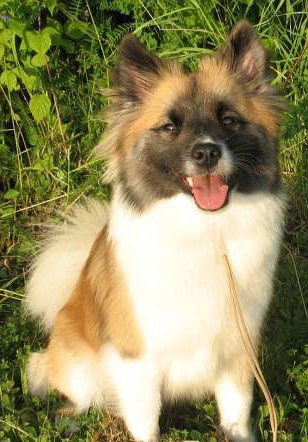

----
Correct answer:  Lowchen
Predicted: 
    Havanese :  0.264228
    Lhasa_apso :  0.429197
    Lowchen :  0.304301


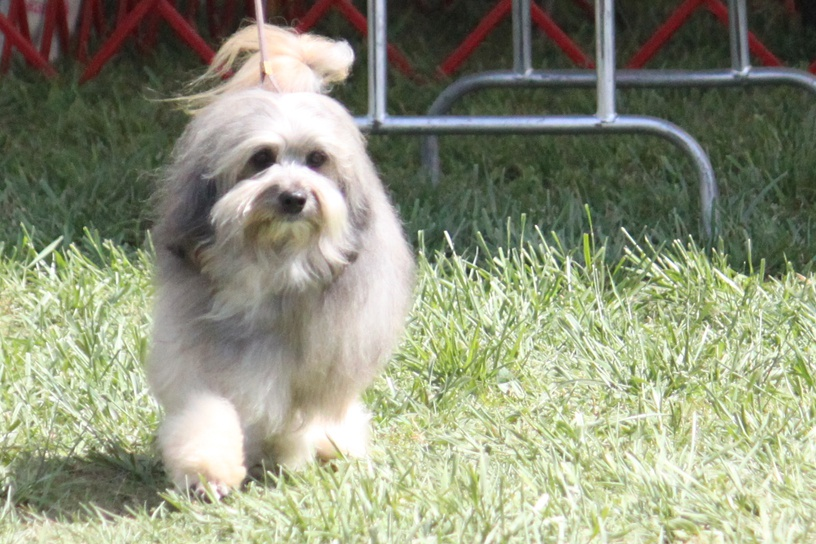

----
Correct answer:  English_cocker_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.0129677
    Cocker_spaniel :  0.0459273
    English_cocker_spaniel :  0.0270048
    English_springer_spaniel :  0.907607


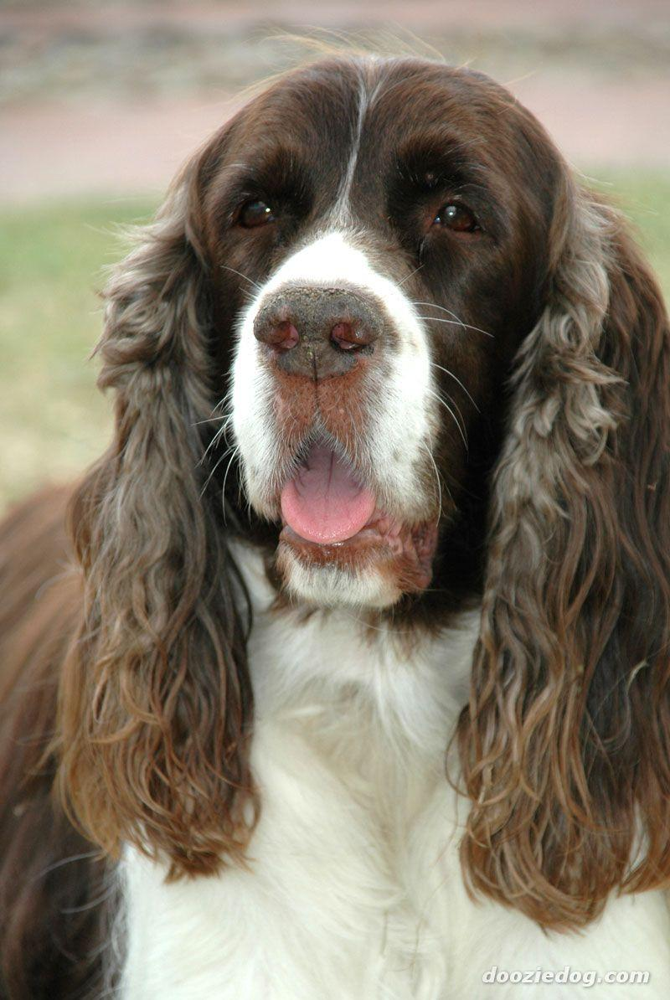

----
Correct answer:  Golden_retriever
Predicted: 
    American_staffordshire_terrier :  0.0148005
    Dachshund :  0.0571293
    German_pinscher :  0.657821
    Golden_retriever :  0.0786291
    Nova_scotia_duck_tolling_retriever :  0.0147068
    Plott :  0.143019


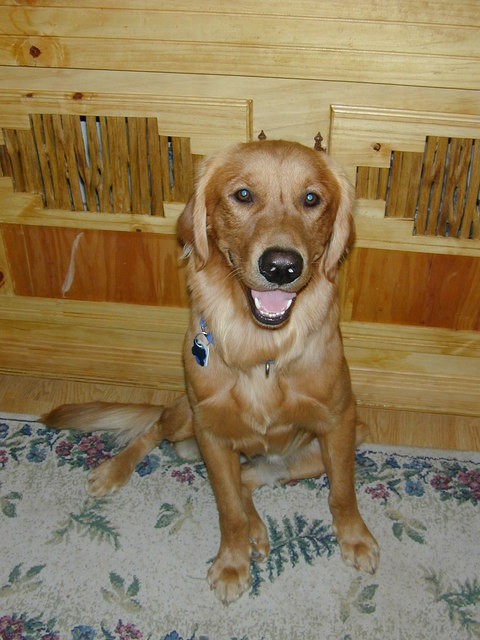

----
Correct answer:  Kuvasz
Predicted: 
    Great_pyrenees :  0.998918


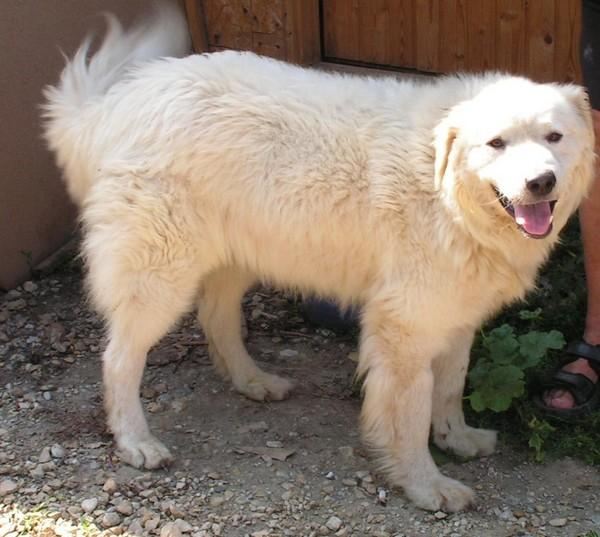

----
Correct answer:  Cane_corso
Predicted: 
    Boxer :  0.117557
    Bullmastiff :  0.649766
    Cane_corso :  0.211632
    Mastiff :  0.0161887


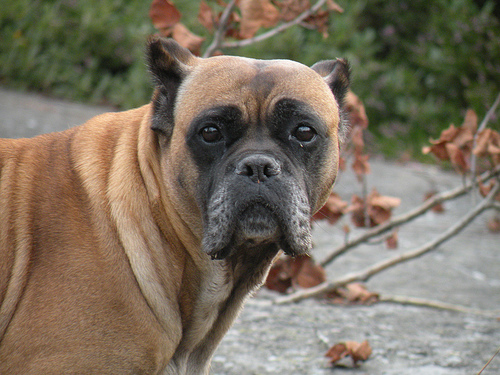

----
Correct answer:  Chihuahua
Predicted: 
    Australian_cattle_dog :  0.817959
    Canaan_dog :  0.062296
    Cardigan_welsh_corgi :  0.0153067
    Chihuahua :  0.080642
    Norwegian_buhund :  0.0167421


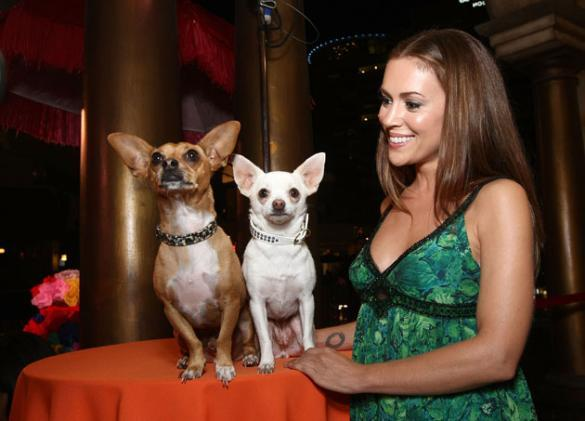

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.798083
    Pembroke_welsh_corgi :  0.19774


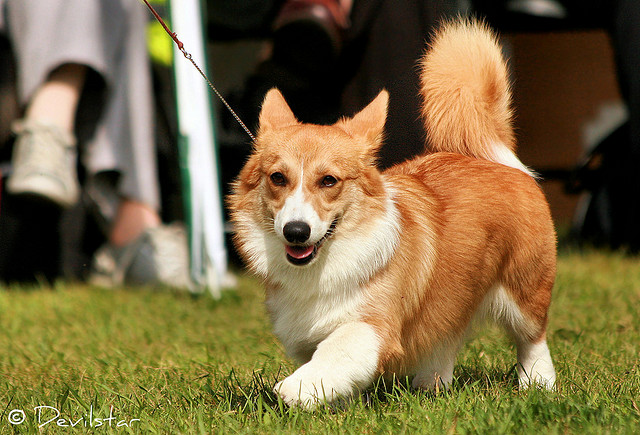

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.488701
    Icelandic_sheepdog :  0.0263117
    Pembroke_welsh_corgi :  0.484647


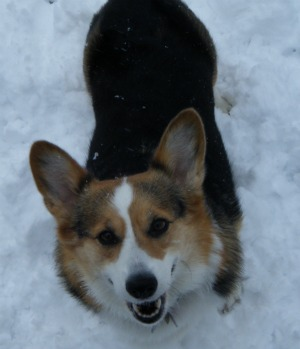

----
Correct answer:  German_pinscher
Predicted: 
    Beauceron :  0.24381
    Doberman_pinscher :  0.378713
    German_pinscher :  0.358529
    Manchester_terrier :  0.0184964


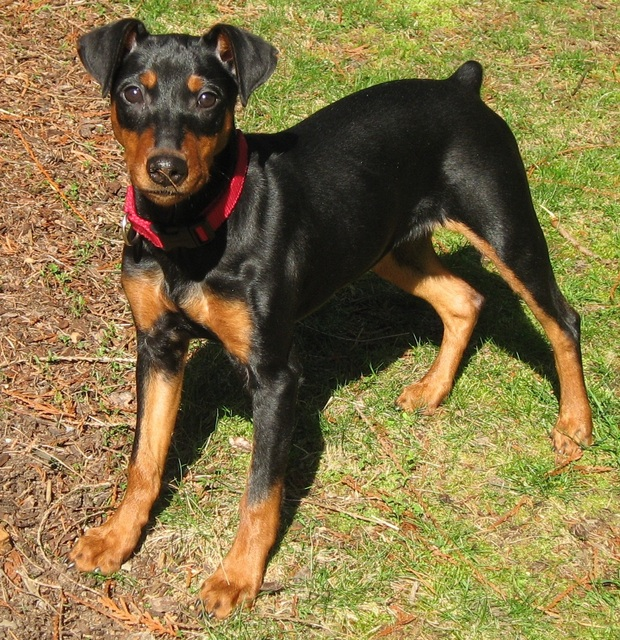

----
Correct answer:  Belgian_malinois
Predicted: 
    Anatolian_shepherd_dog :  0.590855
    Belgian_malinois :  0.184444
    German_shepherd_dog :  0.024464
    Great_dane :  0.147759
    Mastiff :  0.0259945


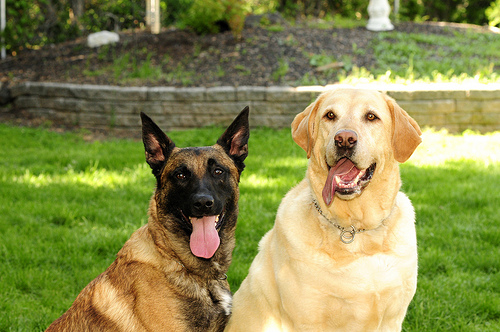

----
Correct answer:  Irish_water_spaniel
Predicted: 
    American_water_spaniel :  0.210571
    Curly-coated_retriever :  0.0609028
    Greyhound :  0.0216725
    Irish_water_spaniel :  0.0820159
    Poodle :  0.61017


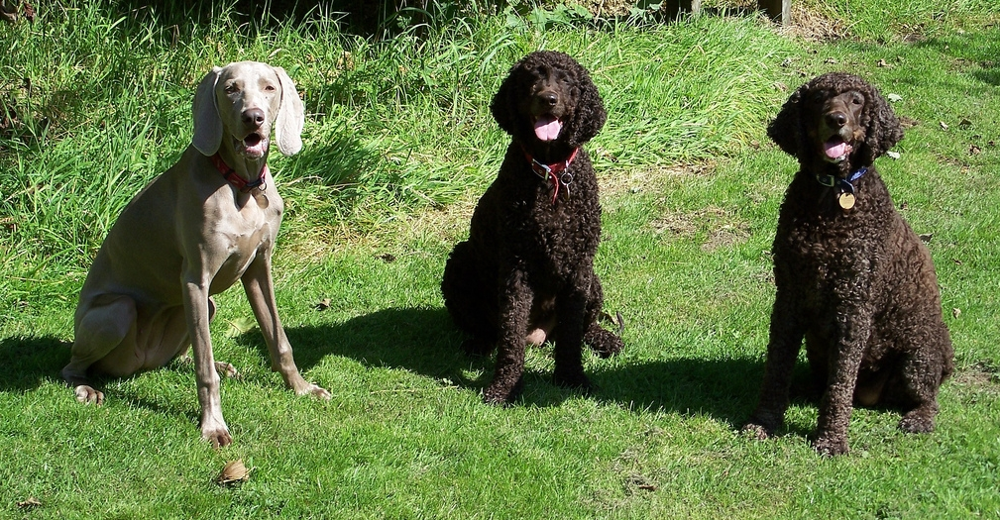

----
Correct answer:  Portuguese_water_dog
Predicted: 
    Kerry_blue_terrier :  0.0971342
    Poodle :  0.749983
    Portuguese_water_dog :  0.131053


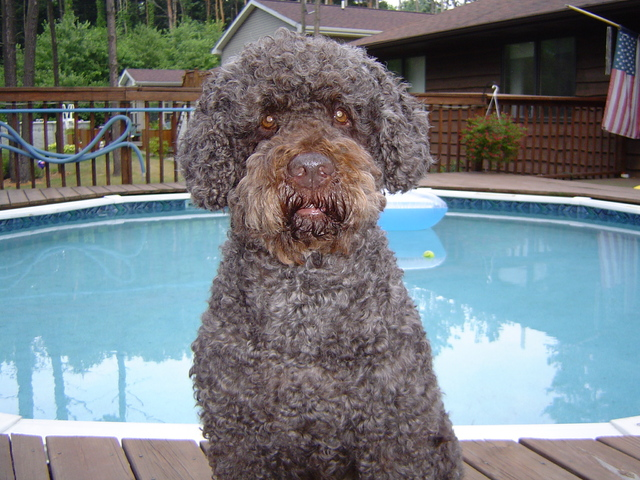

----
Correct answer:  Maltese
Predicted: 
    Bichon_frise :  0.295716
    Chinese_crested :  0.0392031
    Havanese :  0.29869
    Lowchen :  0.0905015
    Maltese :  0.270349


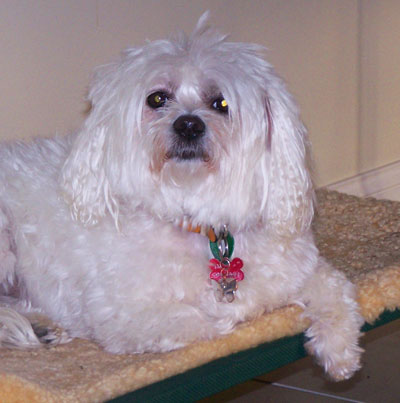

----
Correct answer:  Old_english_sheepdog
Predicted: 
    Bearded_collie :  0.785064
    Old_english_sheepdog :  0.212961


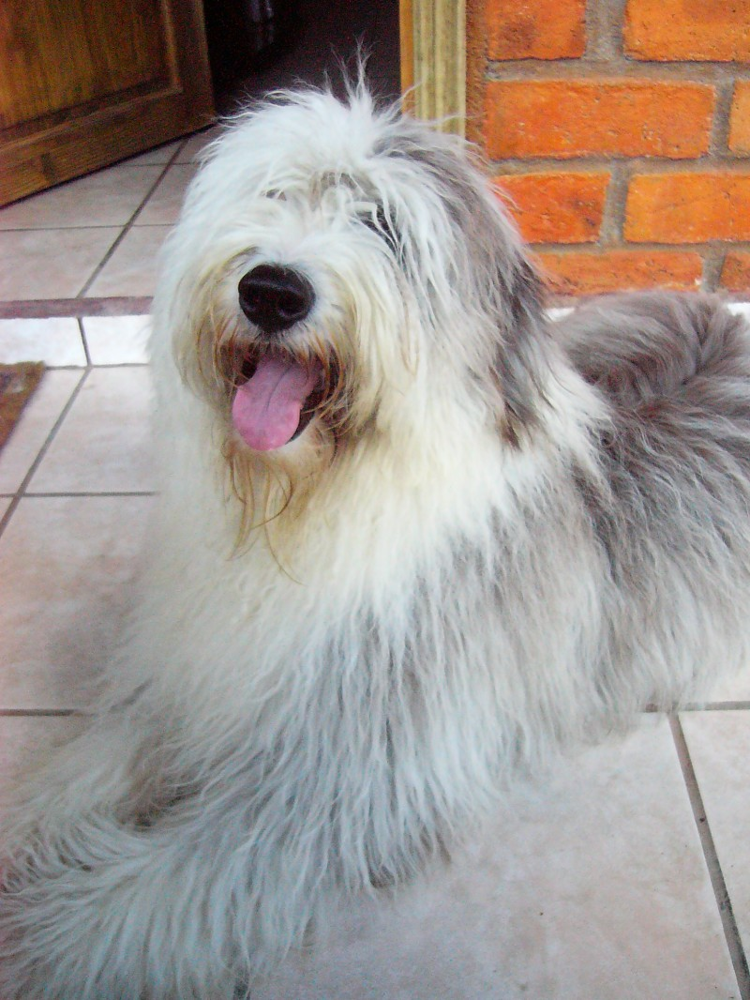

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.849686
    Pembroke_welsh_corgi :  0.145532


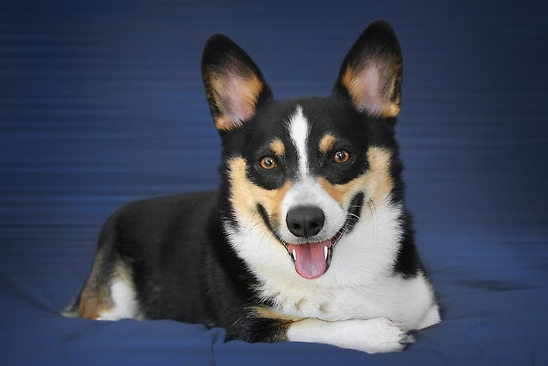

----
Correct answer:  German_wirehaired_pointer
Predicted: 
    Brittany :  0.667854
    English_springer_spaniel :  0.261123
    German_wirehaired_pointer :  0.0441782
    Wirehaired_pointing_griffon :  0.0146324


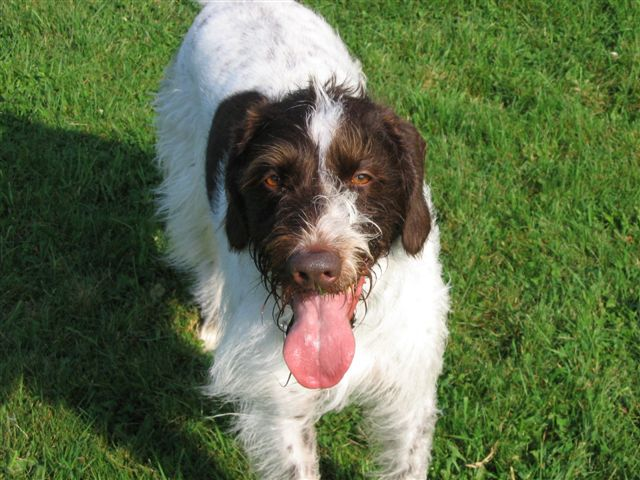

----
Correct answer:  English_springer_spaniel
Predicted: 
    Anatolian_shepherd_dog :  0.280277
    Belgian_malinois :  0.688355
    German_shepherd_dog :  0.0135878


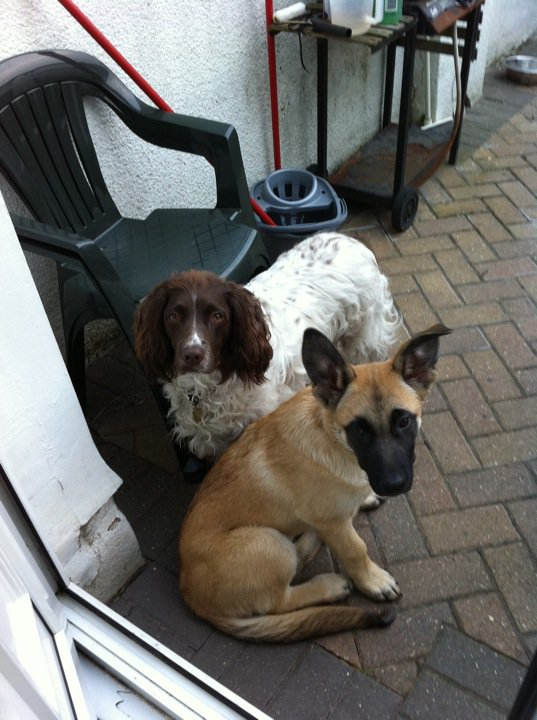

----
Correct answer:  Cavalier_king_charles_spaniel
Predicted: 
    Gordon_setter :  0.979623


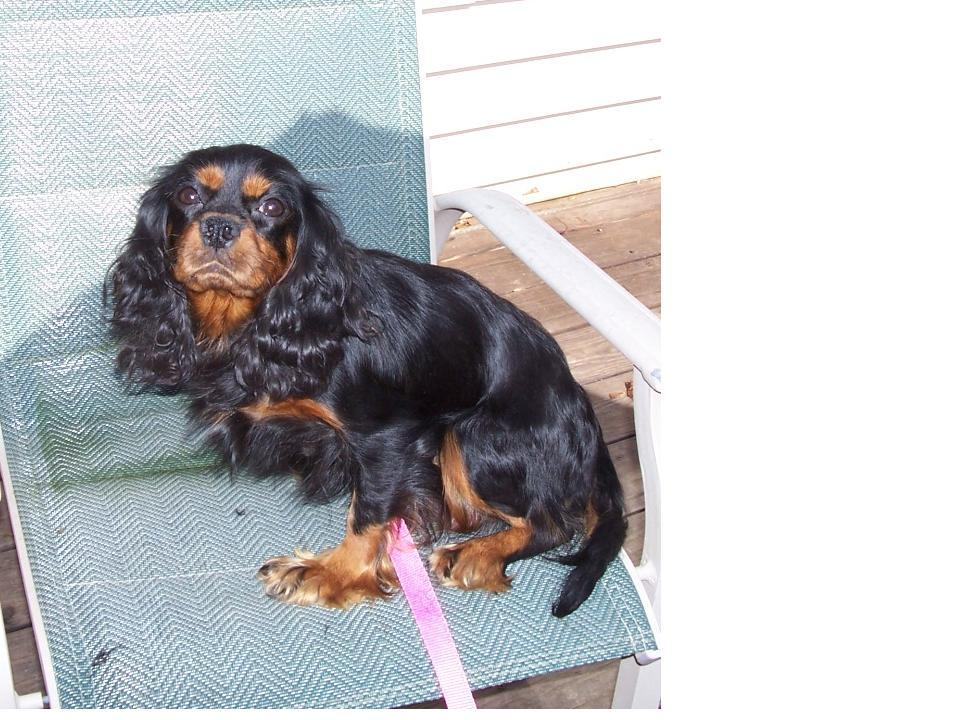

----
Correct answer:  Chinese_shar-pei
Predicted: 
    Cane_corso :  0.0282523
    Chinese_shar-pei :  0.391592
    Dogue_de_bordeaux :  0.574522


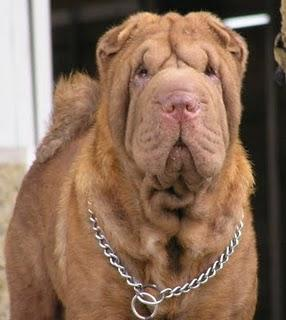

----
Correct answer:  English_springer_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.964086
    English_toy_spaniel :  0.0339959


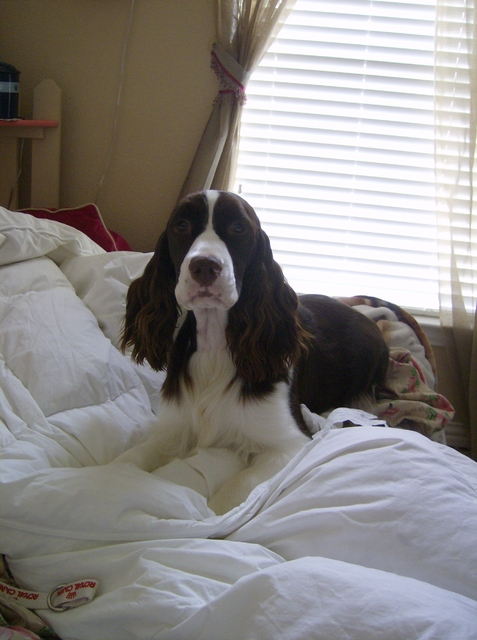

----
Correct answer:  Chow_chow
Predicted: 
    Belgian_sheepdog :  0.954775
    Chow_chow :  0.0444664


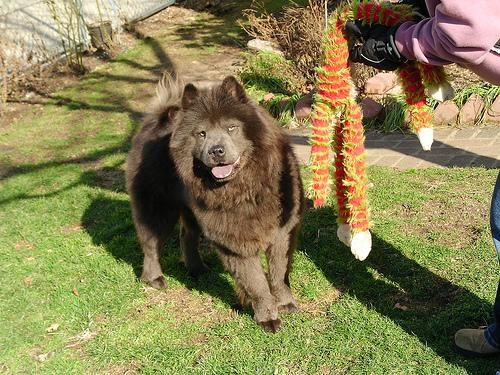

----
Correct answer:  American_foxhound
Predicted: 
    Beagle :  0.991023


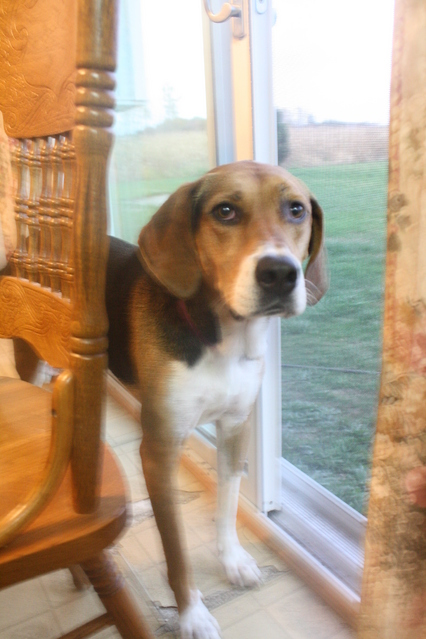

----
Correct answer:  Brittany
Predicted: 
    Brittany :  0.0548093
    Irish_red_and_white_setter :  0.639994
    Welsh_springer_spaniel :  0.304109


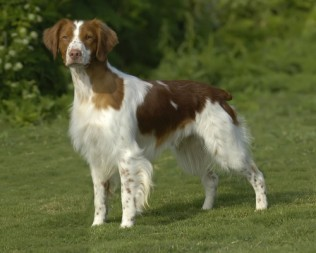

----
Correct answer:  Chihuahua
Predicted: 
    Chihuahua :  0.0107861
    Chinese_crested :  0.024495
    Pomeranian :  0.962806


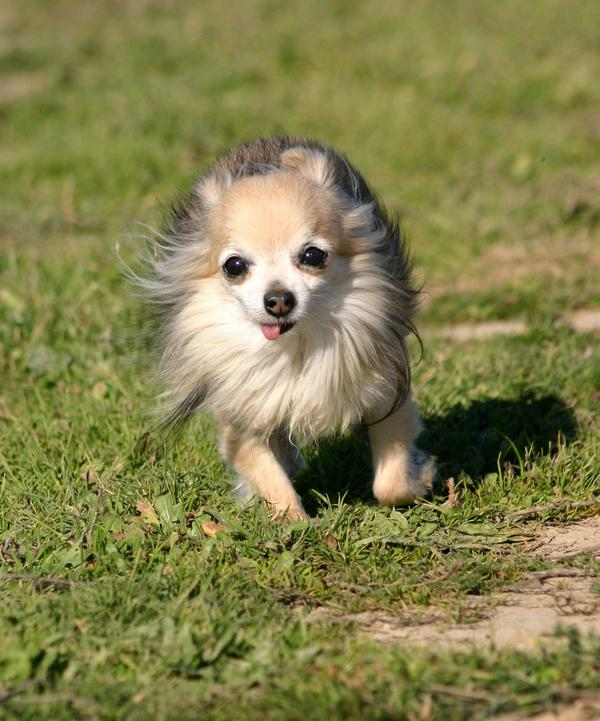

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.727127
    Icelandic_sheepdog :  0.0864467
    Pembroke_welsh_corgi :  0.185086


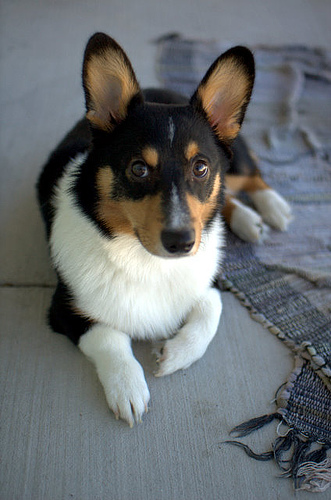

----
Correct answer:  Boxer
Predicted: 
    Boxer :  0.263154
    Bullmastiff :  0.668597
    Cane_corso :  0.0176942
    Mastiff :  0.0468112


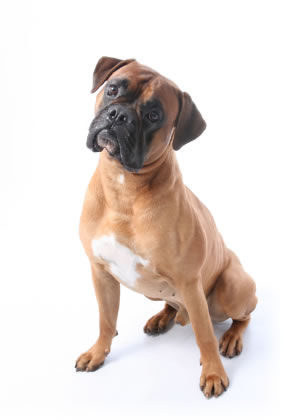

----
Correct answer:  Black_russian_terrier
Predicted: 
    Black_russian_terrier :  0.0407555
    Bouvier_des_flandres :  0.0193491
    Portuguese_water_dog :  0.935634


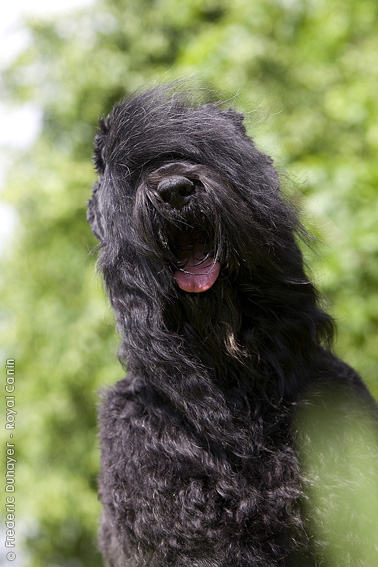

----
Correct answer:  English_toy_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.786048
    English_toy_spaniel :  0.211211


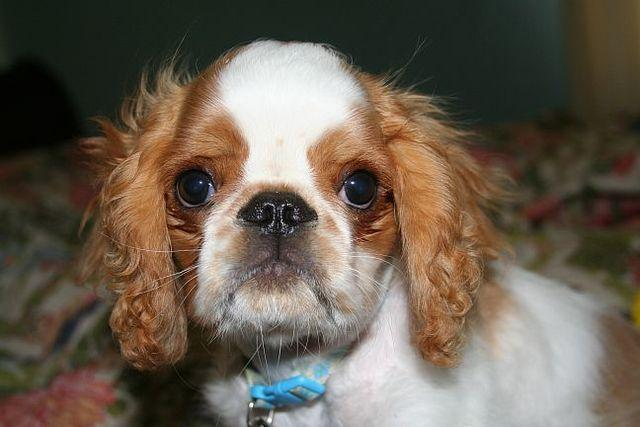

----
Correct answer:  English_springer_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.046184
    Chinese_crested :  0.0179709
    Cocker_spaniel :  0.0412296
    English_springer_spaniel :  0.424889
    English_toy_spaniel :  0.430437
    Irish_red_and_white_setter :  0.0155175


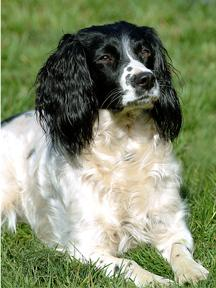

----
Correct answer:  Belgian_sheepdog
Predicted: 
    Belgian_sheepdog :  0.0422812
    Flat-coated_retriever :  0.92371
    Newfoundland :  0.022492


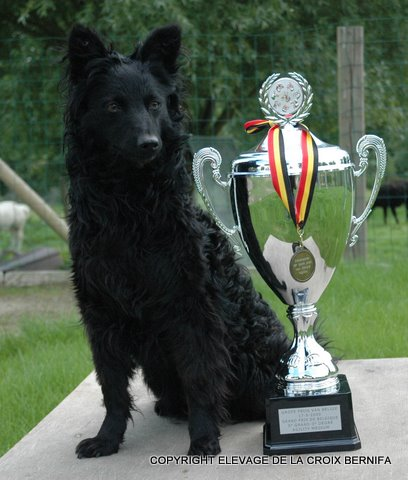

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.600596
    Icelandic_sheepdog :  0.0326718
    Pembroke_welsh_corgi :  0.366445


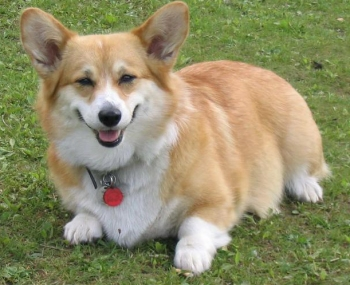

----
Correct answer:  Chinese_shar-pei
Predicted: 
    Chesapeake_bay_retriever :  0.0391118
    Chinese_shar-pei :  0.353531
    Dogue_de_bordeaux :  0.396589
    Nova_scotia_duck_tolling_retriever :  0.19425


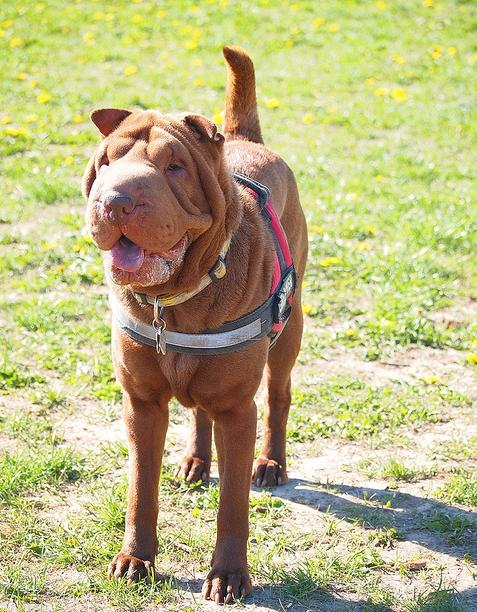

----
Correct answer:  American_water_spaniel
Predicted: 
    American_water_spaniel :  0.210836
    Boykin_spaniel :  0.604129
    Curly-coated_retriever :  0.151064
    Irish_water_spaniel :  0.02056


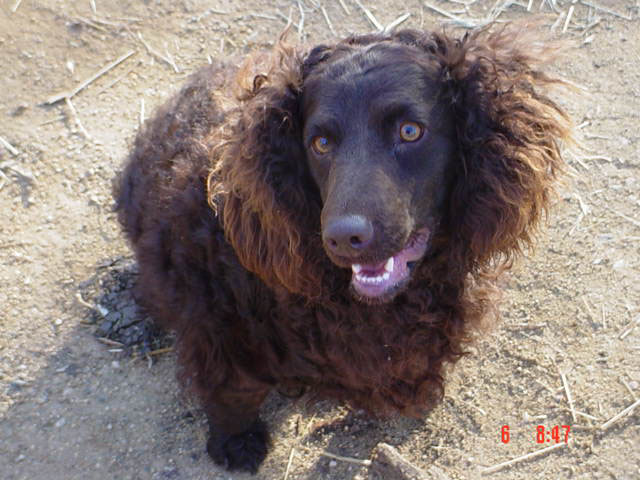

----
Correct answer:  Chihuahua
Predicted: 
    Chinese_crested :  0.647115
    Icelandic_sheepdog :  0.173819
    Norwegian_buhund :  0.162403


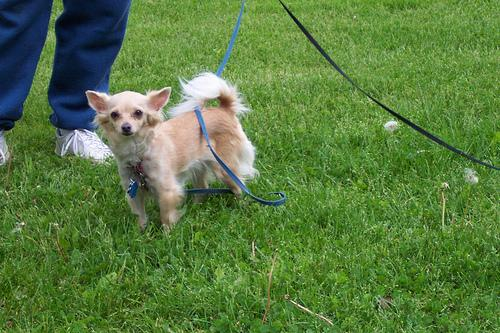

----
Correct answer:  Havanese
Predicted: 
    Havanese :  0.171126
    Lhasa_apso :  0.575433
    Lowchen :  0.250222


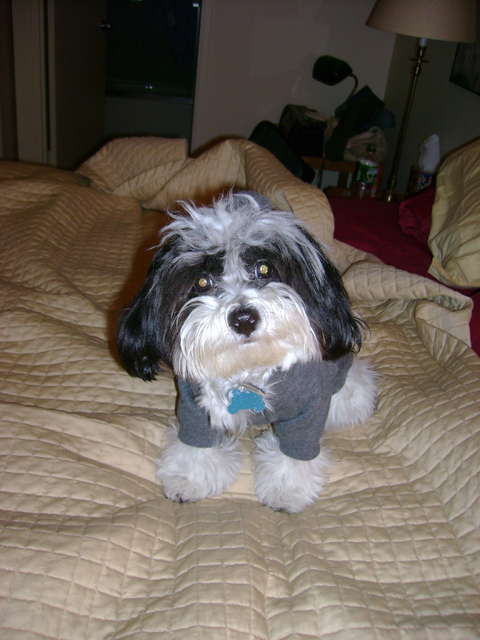

----
Correct answer:  Irish_red_and_white_setter
Predicted: 
    Irish_red_and_white_setter :  0.119003
    Welsh_springer_spaniel :  0.87324


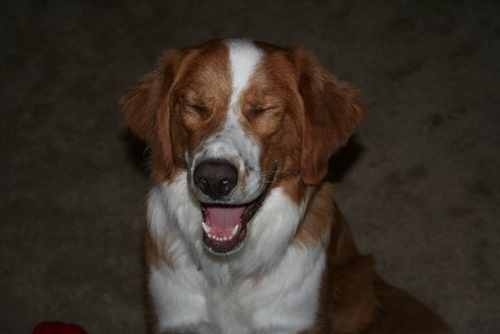

----
Correct answer:  Norwegian_buhund
Predicted: 
    Australian_cattle_dog :  0.038724
    Canaan_dog :  0.959275


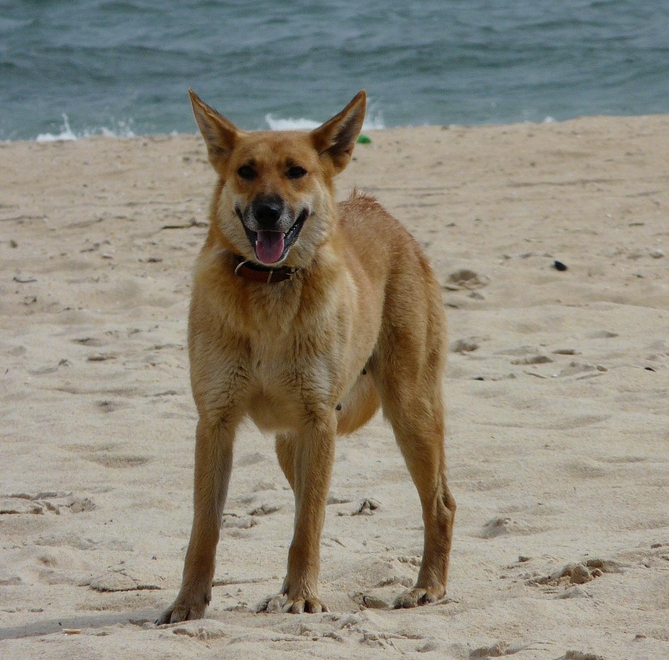

----
Correct answer:  Kuvasz
Predicted: 
    Great_pyrenees :  0.761455
    Kuvasz :  0.238352


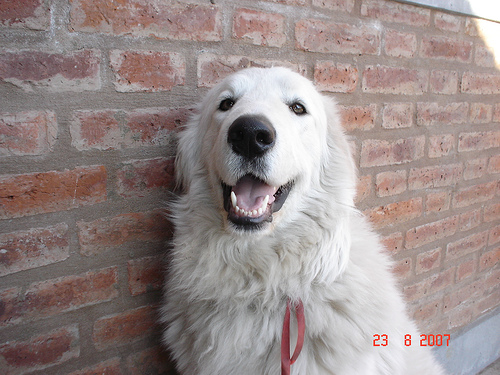

----
Correct answer:  Old_english_sheepdog
Predicted: 
    Bearded_collie :  0.914888
    Old_english_sheepdog :  0.0839161


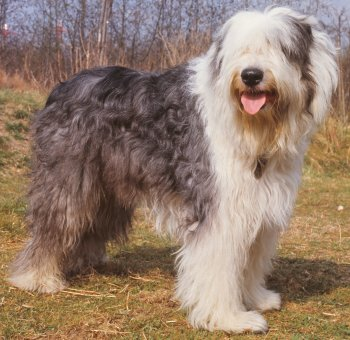

----
Correct answer:  Afghan_hound
Predicted: 
    Afghan_hound :  0.101433
    Briard :  0.898549


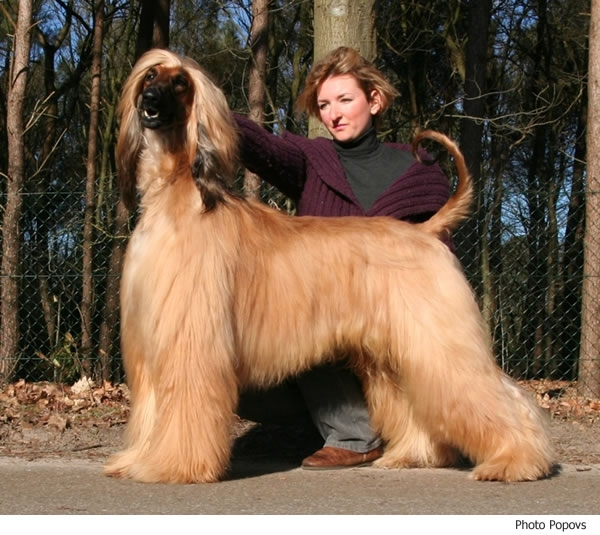

----
Correct answer:  Kuvasz
Predicted: 
    Great_pyrenees :  0.894428
    Kuvasz :  0.105542


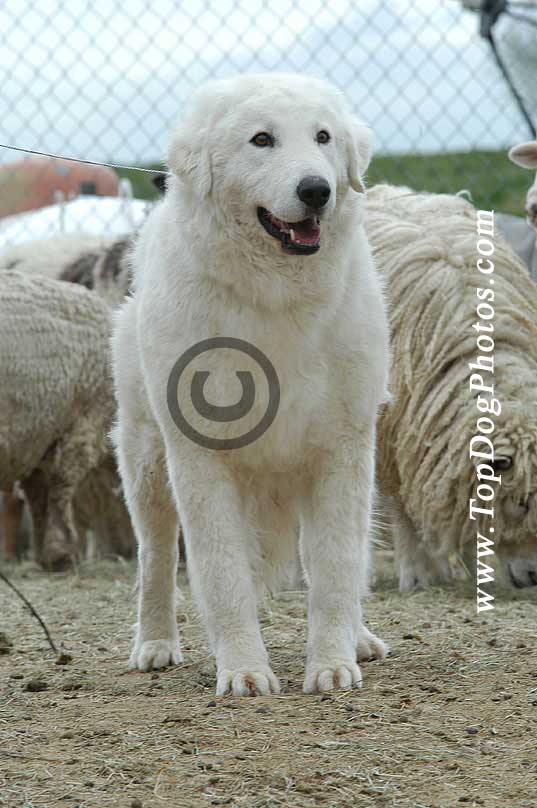

----
Correct answer:  Silky_terrier
Predicted: 
    Silky_terrier :  0.358287
    Yorkshire_terrier :  0.641519


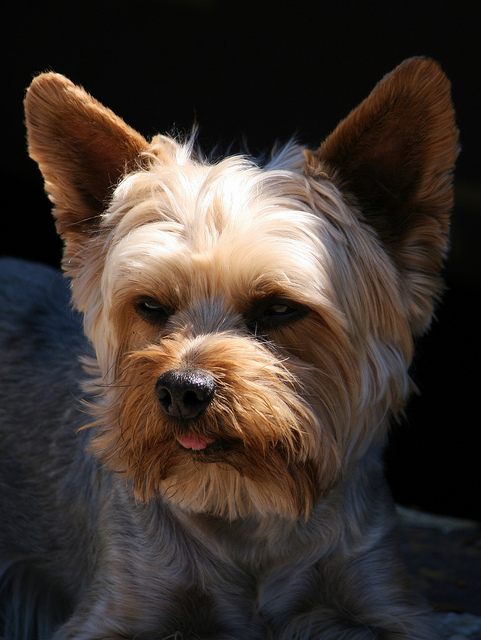

----
Correct answer:  Australian_terrier
Predicted: 
    Australian_terrier :  0.211052
    Norwich_terrier :  0.781461


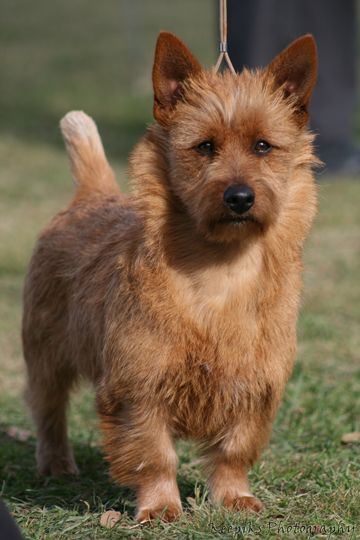

----
Correct answer:  Norwegian_buhund
Predicted: 
    Finnish_spitz :  0.0116516
    Icelandic_sheepdog :  0.726278
    Norwegian_buhund :  0.237542
    Pomeranian :  0.0231508


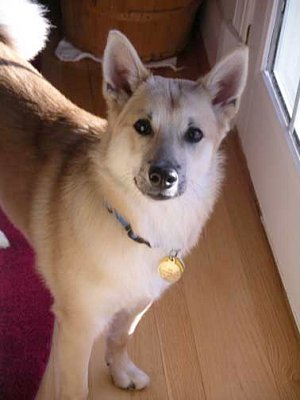

----
Correct answer:  German_pinscher
Predicted: 
    Doberman_pinscher :  0.652789
    German_pinscher :  0.337884


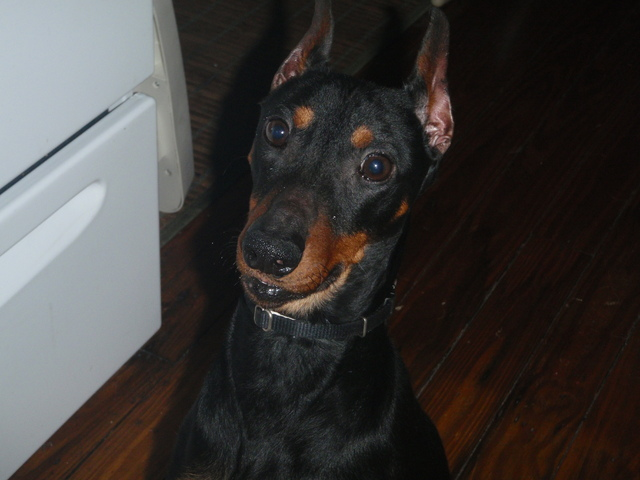

----
Correct answer:  Irish_wolfhound
Predicted: 
    Bearded_collie :  0.865903
    Irish_wolfhound :  0.126299


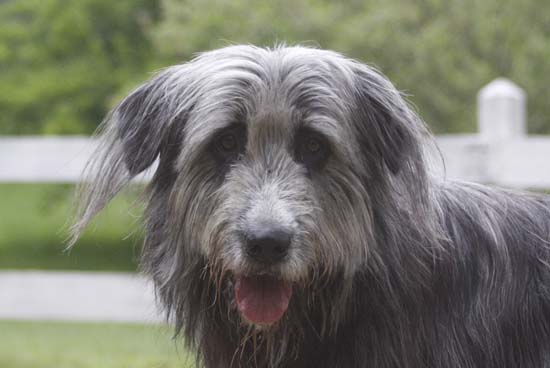

----
Correct answer:  Irish_setter
Predicted: 
    Dachshund :  0.025659
    Golden_retriever :  0.73383
    Irish_setter :  0.238065


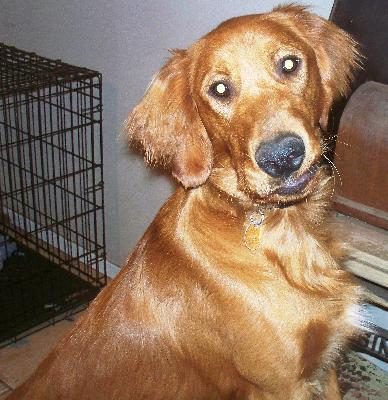

----
Correct answer:  German_pinscher
Predicted: 
    Doberman_pinscher :  0.909468
    German_pinscher :  0.081784


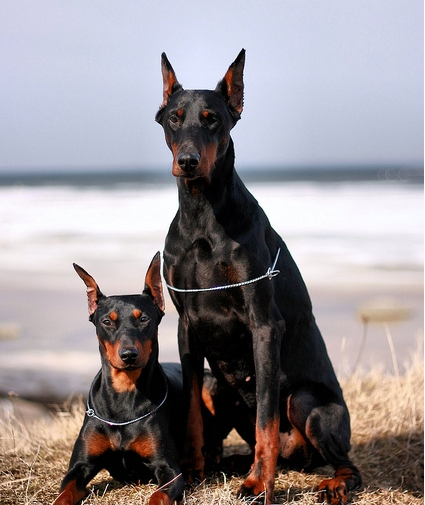

----
Correct answer:  Havanese
Predicted: 
    Havanese :  0.132375
    Portuguese_water_dog :  0.834799
    Wirehaired_pointing_griffon :  0.0258674


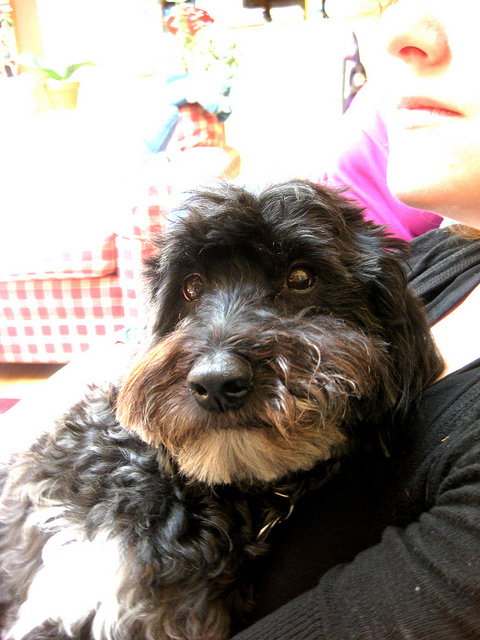

----
Correct answer:  Kerry_blue_terrier
Predicted: 
    Kerry_blue_terrier :  0.449291
    Lakeland_terrier :  0.495561
    Portuguese_water_dog :  0.0545951


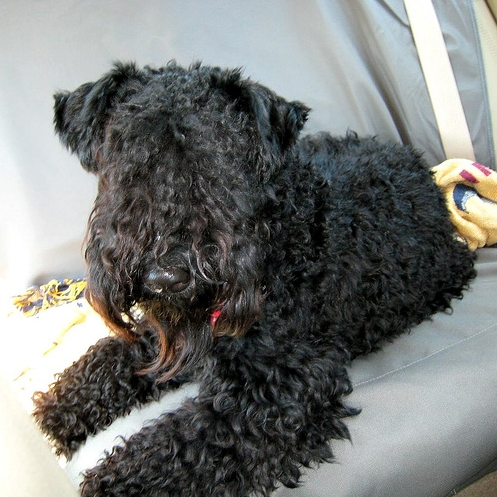

----
Correct answer:  Bullmastiff
Predicted: 
    Anatolian_shepherd_dog :  0.373023
    Bullmastiff :  0.182414
    Cane_corso :  0.0167918
    Mastiff :  0.415409


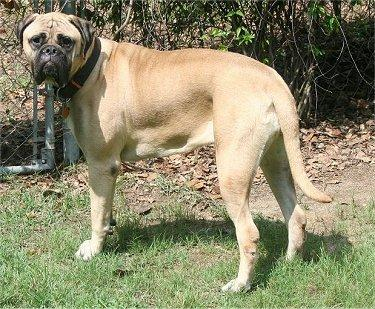

----
Correct answer:  Collie
Predicted: 
    Alaskan_malamute :  0.972559


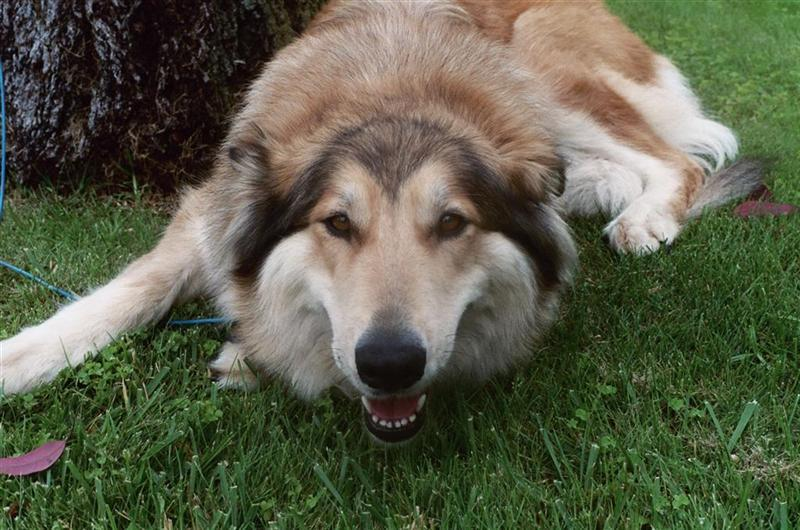

----
Correct answer:  Havanese
Predicted: 
    Havanese :  0.148255
    Lhasa_apso :  0.78323
    Lowchen :  0.0536238
    Maltese :  0.0139001


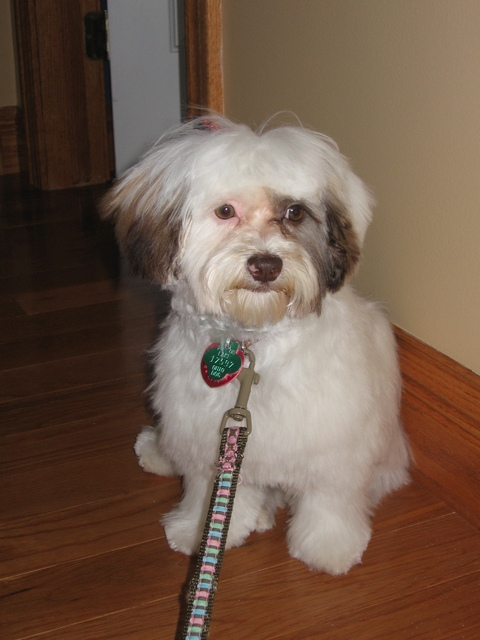

----
Correct answer:  Poodle
Predicted: 
    American_water_spaniel :  0.0230531
    Irish_water_spaniel :  0.144064
    Portuguese_water_dog :  0.812424


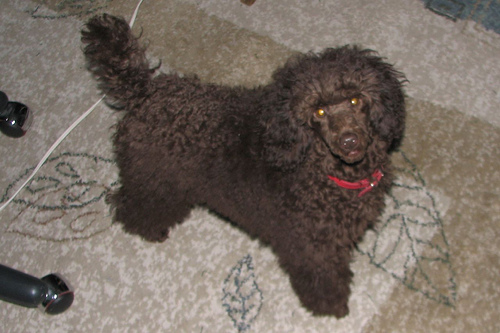

----
Correct answer:  Dachshund
Predicted: 
    American_water_spaniel :  0.0305336
    Boykin_spaniel :  0.564698
    Cavalier_king_charles_spaniel :  0.102837
    Cocker_spaniel :  0.0258023
    Dachshund :  0.154286
    English_cocker_spaniel :  0.0686453
    English_toy_spaniel :  0.0144484
    Field_spaniel :  0.0152769
    Irish_setter :  0.0224117


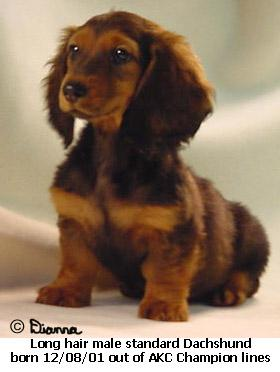

----
Correct answer:  American_water_spaniel
Predicted: 
    Boykin_spaniel :  0.995738


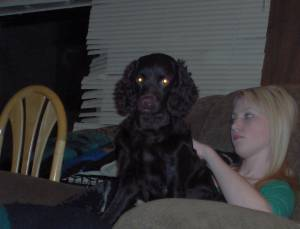

----
Correct answer:  Labrador_retriever
Predicted: 
    Chesapeake_bay_retriever :  0.155152
    German_shorthaired_pointer :  0.76615
    German_wirehaired_pointer :  0.0667903


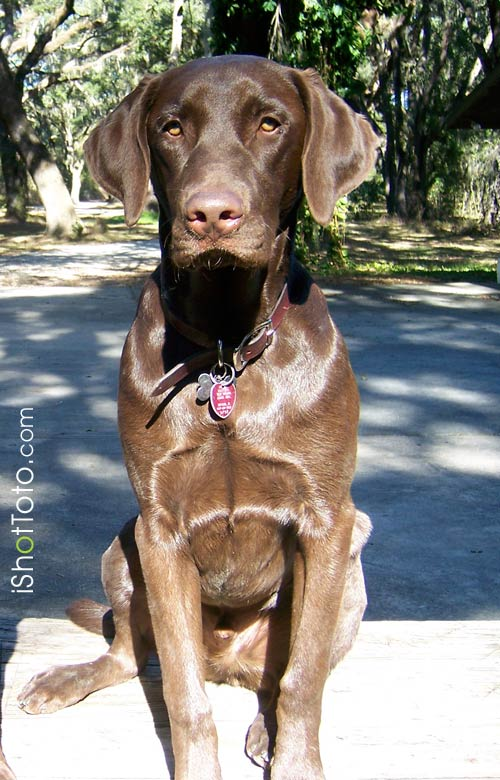

----
Correct answer:  Welsh_springer_spaniel
Predicted: 
    Boykin_spaniel :  0.0120023
    Dachshund :  0.0264586
    Field_spaniel :  0.0253613
    Flat-coated_retriever :  0.858035
    Golden_retriever :  0.0412464
    Irish_setter :  0.012723


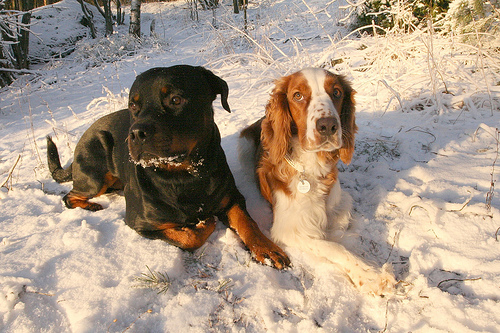

----
Correct answer:  Yorkshire_terrier
Predicted: 
    Australian_terrier :  0.0138859
    Cairn_terrier :  0.067333
    Glen_of_imaal_terrier :  0.0314044
    Norfolk_terrier :  0.0529099
    Silky_terrier :  0.644501
    Yorkshire_terrier :  0.175953


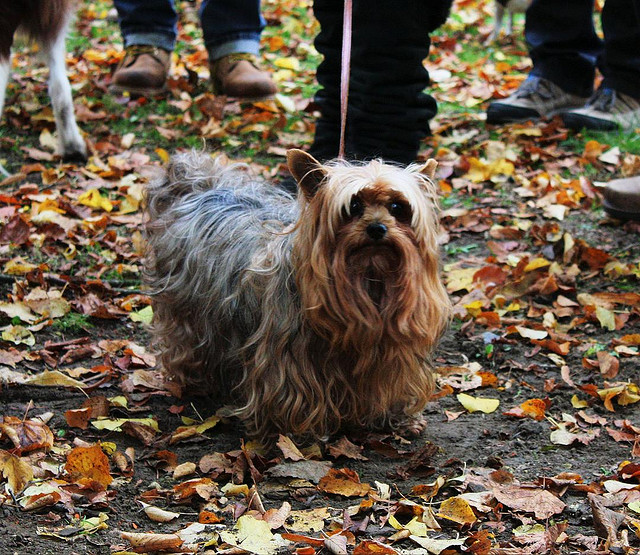

----
Correct answer:  Flat-coated_retriever
Predicted: 
    Boykin_spaniel :  0.710592
    Curly-coated_retriever :  0.0315373
    Flat-coated_retriever :  0.0465856
    German_wirehaired_pointer :  0.201237


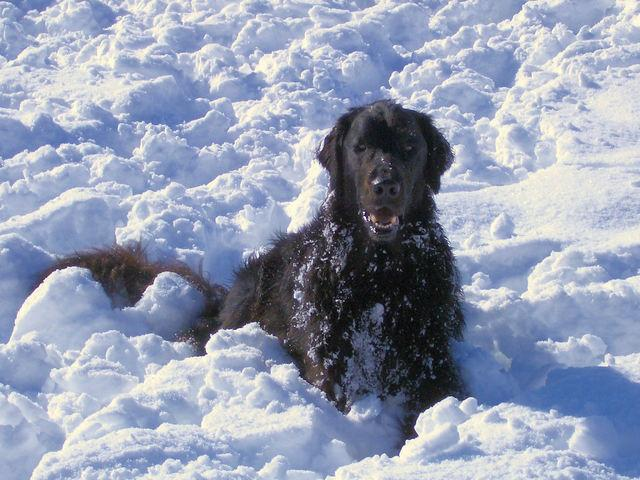

----
Correct answer:  Irish_setter
Predicted: 
    Boykin_spaniel :  0.806102
    Field_spaniel :  0.0213837
    Irish_setter :  0.165313


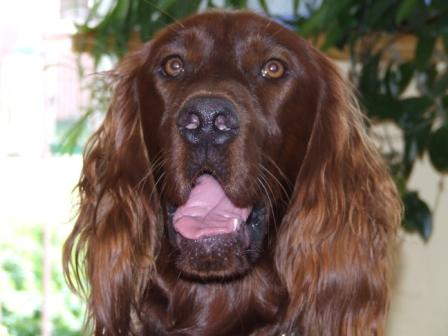

----
Correct answer:  Cocker_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.53102
    Cocker_spaniel :  0.413661
    English_toy_spaniel :  0.0480707


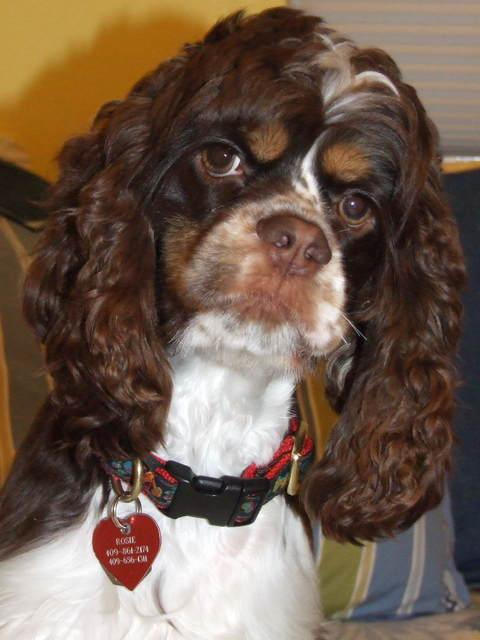

----
Correct answer:  Glen_of_imaal_terrier
Predicted: 
    Glen_of_imaal_terrier :  0.159968
    Irish_wolfhound :  0.823224


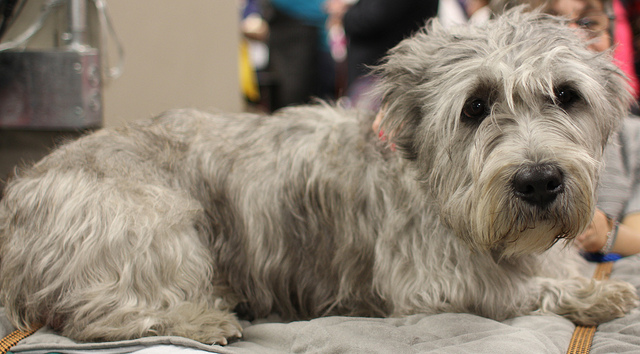

----
Correct answer:  Great_dane
Predicted: 
    Anatolian_shepherd_dog :  0.547755
    Boxer :  0.0601713
    Bullmastiff :  0.0954142
    Cane_corso :  0.105188
    Great_dane :  0.135792
    Mastiff :  0.0354902
    Plott :  0.0172157


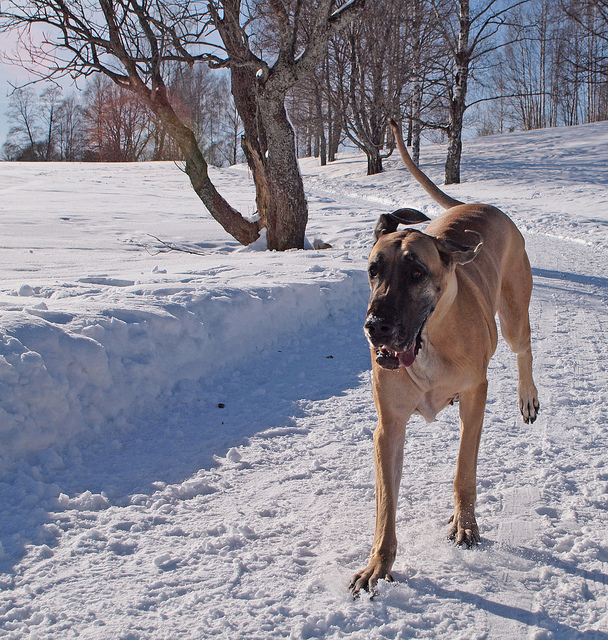

----
Correct answer:  Finnish_spitz
Predicted: 
    Basenji :  0.297824
    Finnish_spitz :  0.144403
    Ibizan_hound :  0.0336868
    Icelandic_sheepdog :  0.468051
    Norwegian_buhund :  0.0278403
    Pembroke_welsh_corgi :  0.0194272


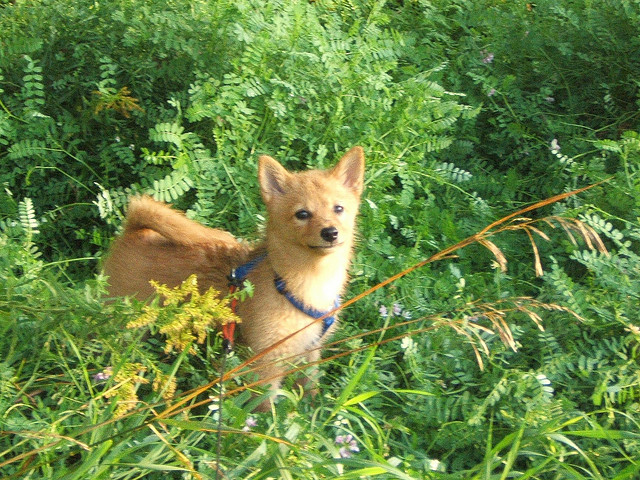

----
Correct answer:  Akita
Predicted: 
    Akita :  0.0846614
    Alaskan_malamute :  0.491787
    Australian_cattle_dog :  0.0174169
    Norwegian_lundehund :  0.395927


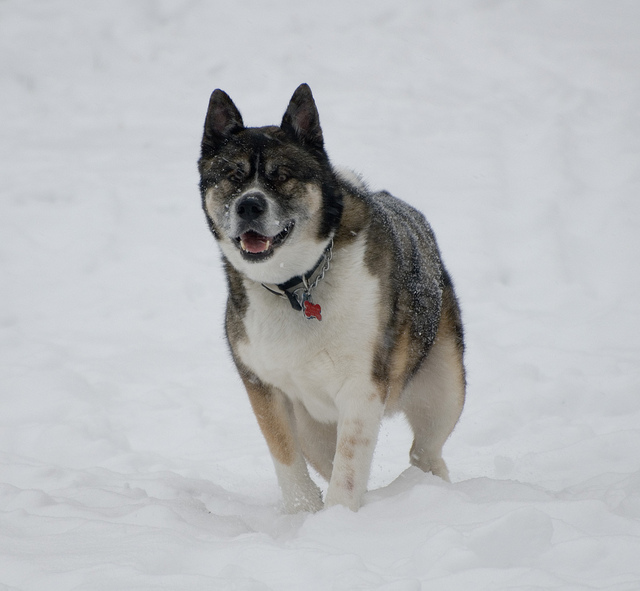

----
Correct answer:  German_wirehaired_pointer
Predicted: 
    German_wirehaired_pointer :  0.141429
    Irish_wolfhound :  0.029856
    Wirehaired_pointing_griffon :  0.826605


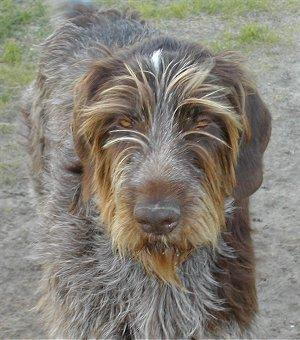

----
Correct answer:  Bullmastiff
Predicted: 
    Bullmastiff :  0.049155
    Cane_corso :  0.939759


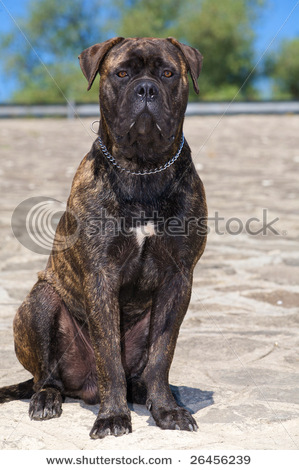

----
Correct answer:  Otterhound
Predicted: 
    Bearded_collie :  0.524366
    Briard :  0.347315
    Otterhound :  0.103961
    Petit_basset_griffon_vendeen :  0.0102201
    Wirehaired_pointing_griffon :  0.0108894


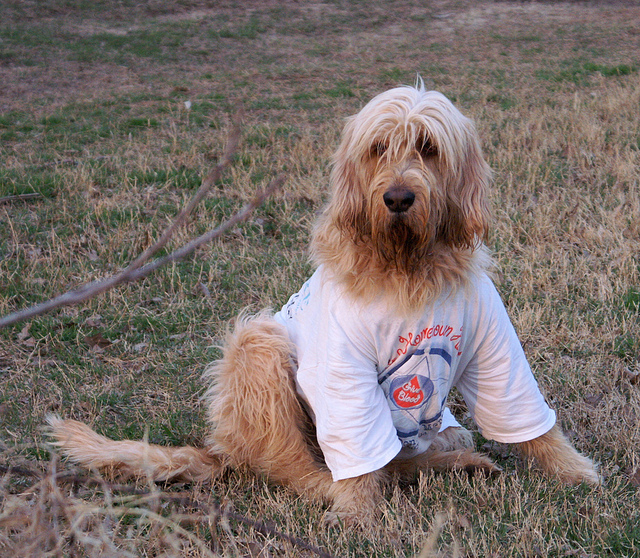

----
Correct answer:  Giant_schnauzer
Predicted: 
    Black_russian_terrier :  0.0604358
    Bouvier_des_flandres :  0.732446
    Briard :  0.080603
    Giant_schnauzer :  0.0633931
    Kerry_blue_terrier :  0.0130676
    Portuguese_water_dog :  0.0409486


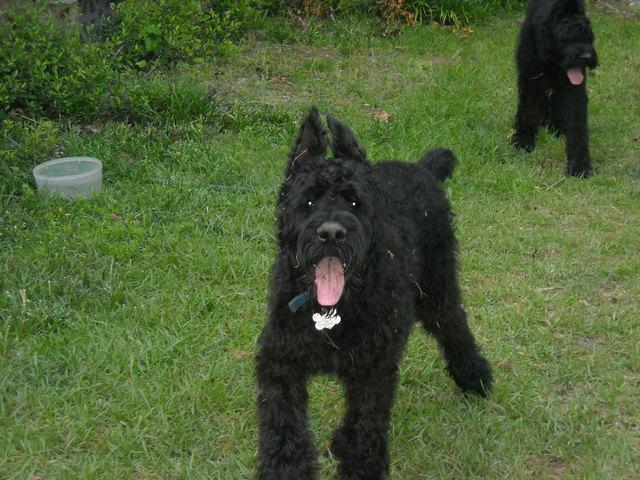

----
Correct answer:  English_setter
Predicted: 
    Bluetick_coonhound :  0.0124504
    Cocker_spaniel :  0.0946427
    English_setter :  0.13698
    English_toy_spaniel :  0.0241135
    German_wirehaired_pointer :  0.232241
    Gordon_setter :  0.47615


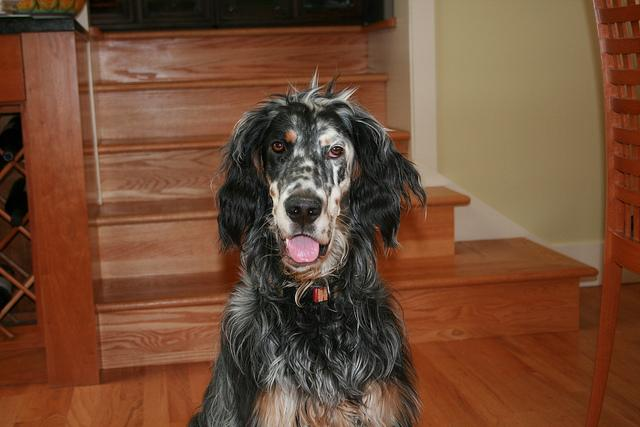

----
Correct answer:  Dogue_de_bordeaux
Predicted: 
    Bulldog :  0.8587
    Dogue_de_bordeaux :  0.13375


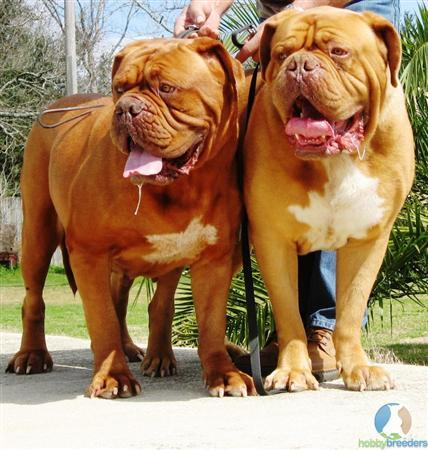

----
Correct answer:  Lowchen
Predicted: 
    Affenpinscher :  0.111964
    Havanese :  0.761835
    Lowchen :  0.0944005
    Miniature_schnauzer :  0.020277


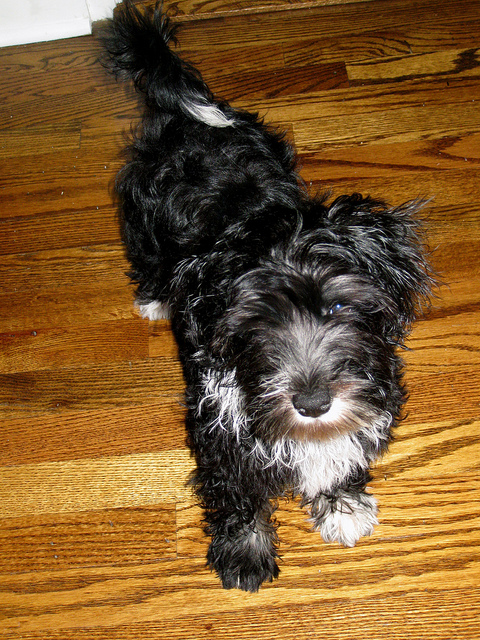

----
Correct answer:  Kuvasz
Predicted: 
    American_eskimo_dog :  0.0725136
    Great_pyrenees :  0.874642
    Kuvasz :  0.0514428


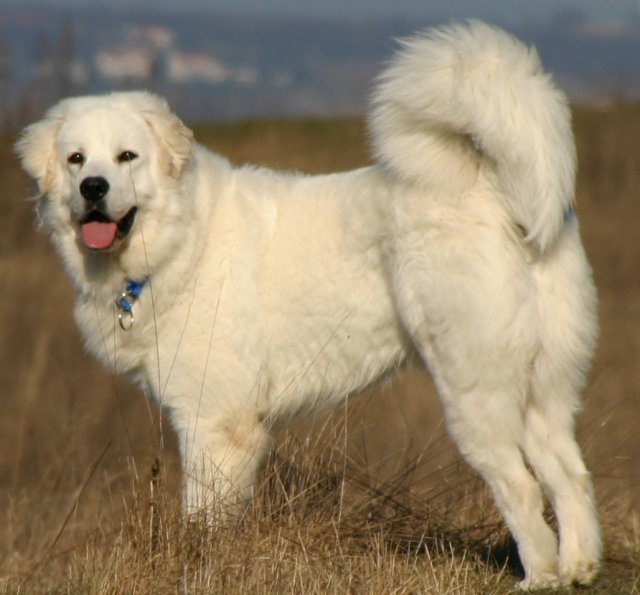

----
Correct answer:  Italian_greyhound
Predicted: 
    Greyhound :  0.599995
    Italian_greyhound :  0.390659


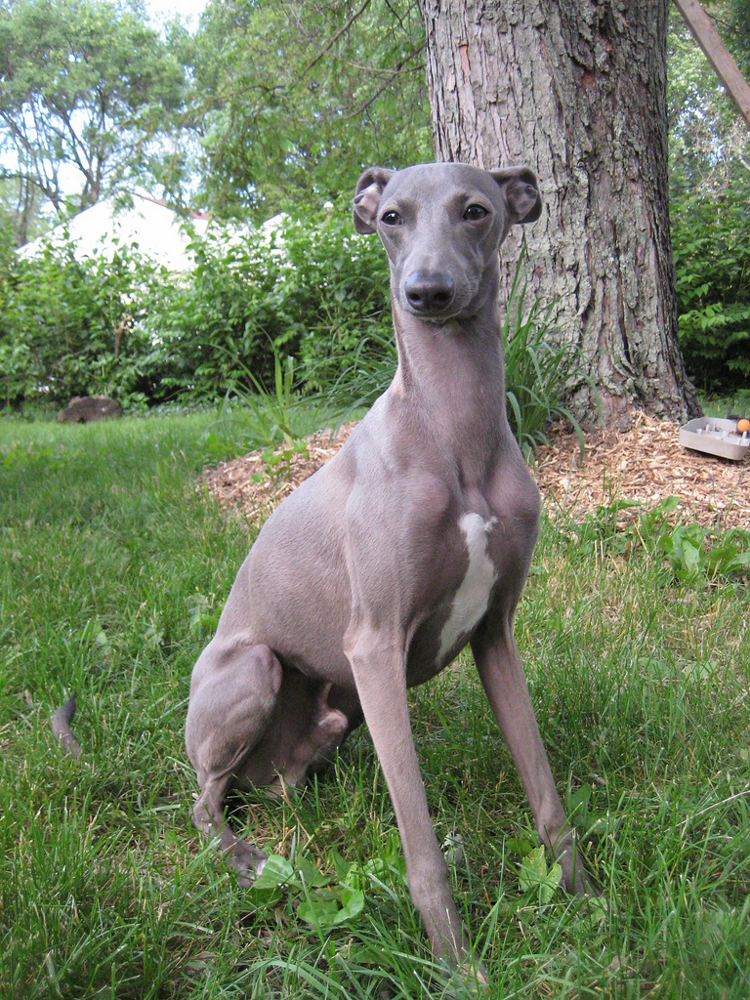

----
Correct answer:  Afghan_hound
Predicted: 
    Irish_wolfhound :  0.993144


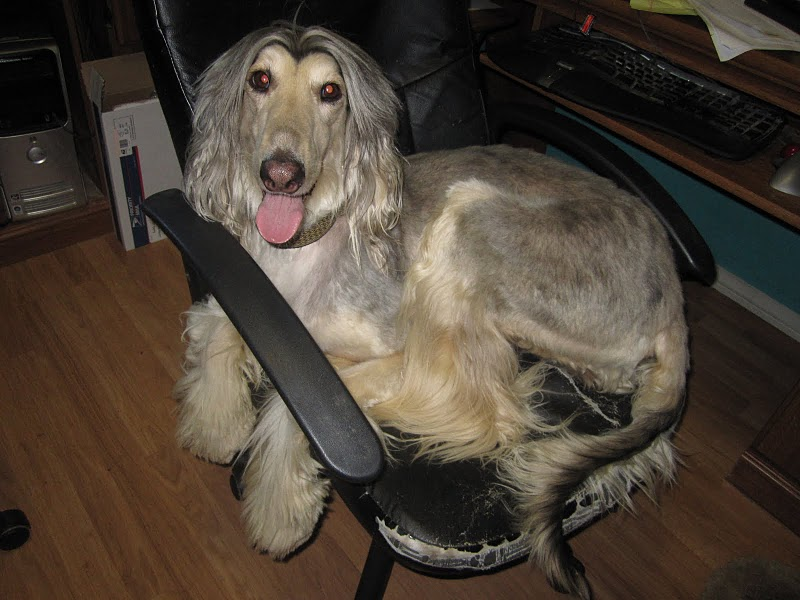

----
Correct answer:  Lhasa_apso
Predicted: 
    Afghan_hound :  0.226159
    Chinese_crested :  0.50727
    Lowchen :  0.0111292
    Petit_basset_griffon_vendeen :  0.246085


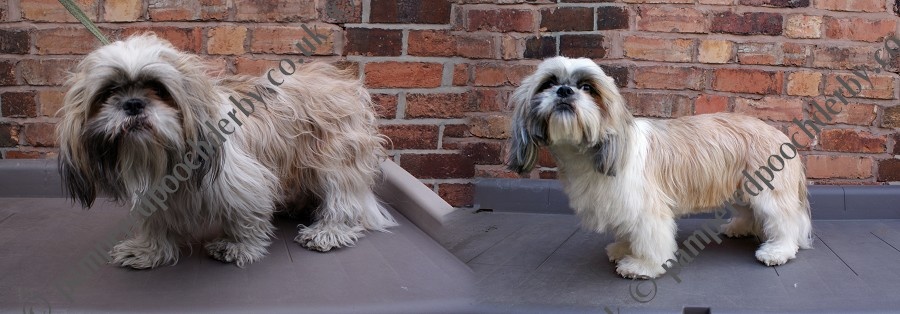

----
Correct answer:  Great_dane
Predicted: 
    Great_dane :  0.41228
    Greyhound :  0.585953


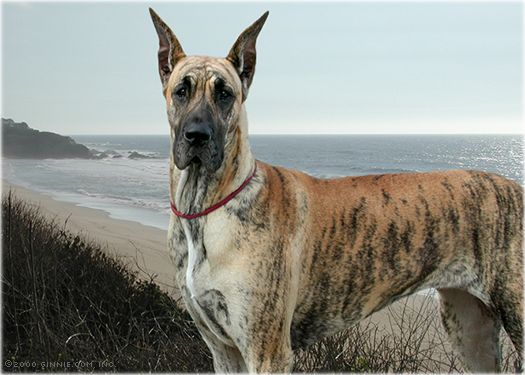

----
Correct answer:  Norfolk_terrier
Predicted: 
    Brussels_griffon :  0.607347
    Norfolk_terrier :  0.350047
    Norwich_terrier :  0.0405566


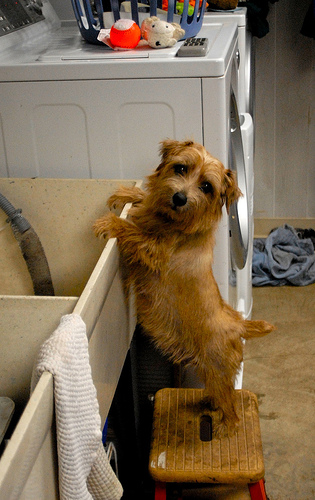

----
Correct answer:  Cane_corso
Predicted: 
    Bearded_collie :  0.0149709
    Cane_corso :  0.064488
    Flat-coated_retriever :  0.661164
    Newfoundland :  0.227643


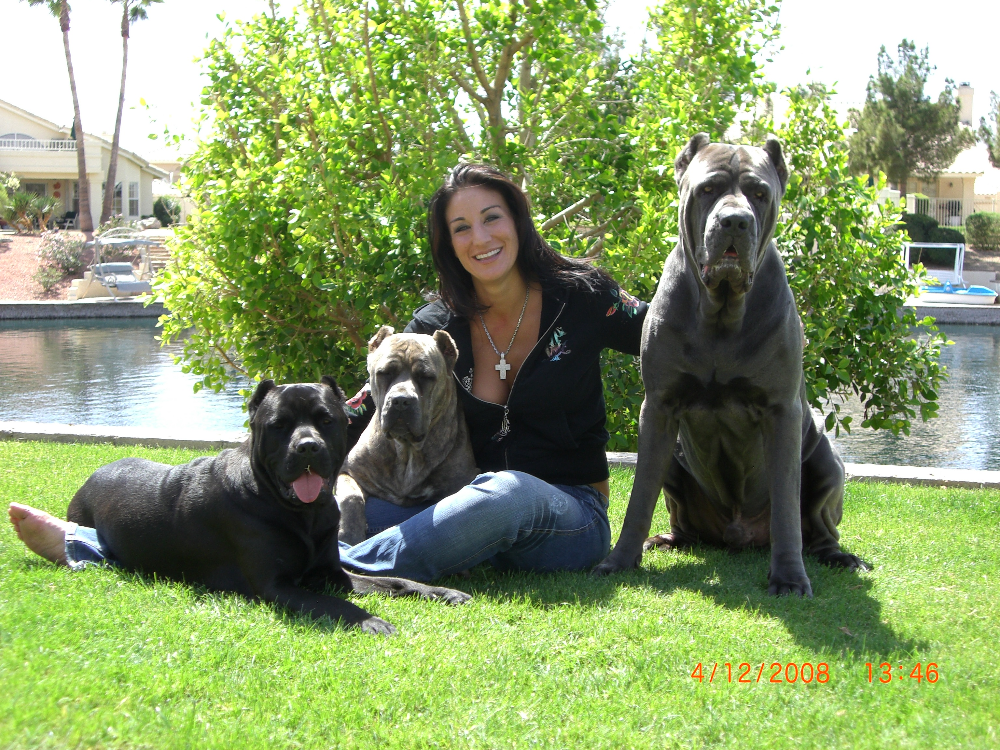

----
Correct answer:  German_wirehaired_pointer
Predicted: 
    Portuguese_water_dog :  0.0346365
    Wirehaired_pointing_griffon :  0.94474


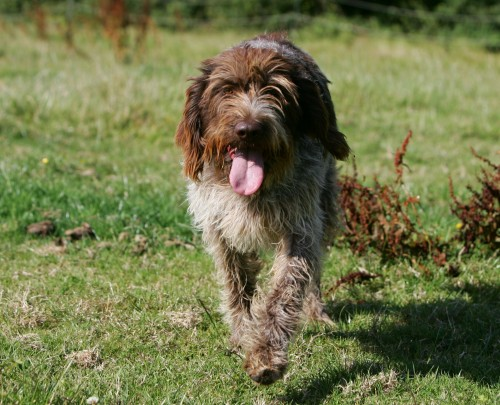

----
Correct answer:  Silky_terrier
Predicted: 
    Silky_terrier :  0.0766667
    Yorkshire_terrier :  0.923235


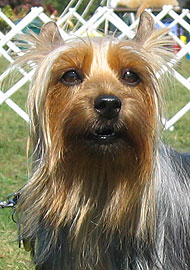

----
Correct answer:  Mastiff
Predicted: 
    Bullmastiff :  0.430722
    Cane_corso :  0.185908
    Mastiff :  0.354392
    Plott :  0.0215671


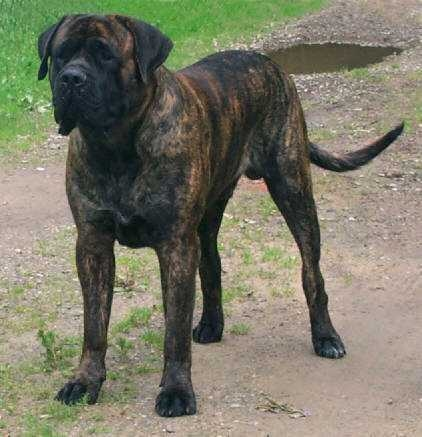

----
Correct answer:  Norfolk_terrier
Predicted: 
    Golden_retriever :  0.986468


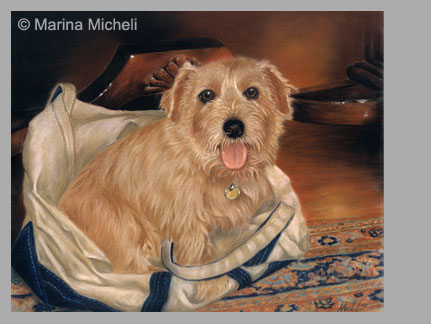

----
Correct answer:  Black_russian_terrier
Predicted: 
    Black_russian_terrier :  0.0600781
    Bouvier_des_flandres :  0.184058
    Briard :  0.0226275
    Portuguese_water_dog :  0.731055


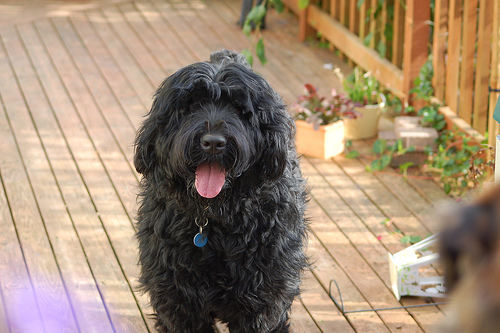

----
Correct answer:  Newfoundland
Predicted: 
    American_water_spaniel :  0.0126293
    Boykin_spaniel :  0.877303
    Briard :  0.0190907
    Field_spaniel :  0.0130093
    Wirehaired_pointing_griffon :  0.0521648


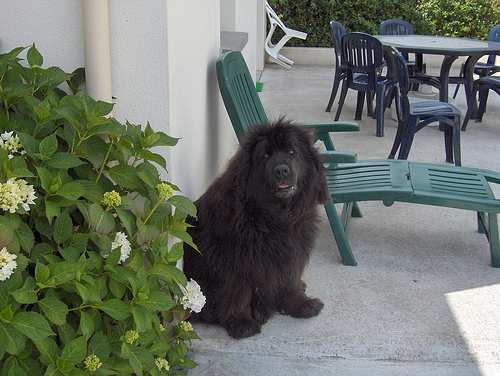

----
Correct answer:  Pointer
Predicted: 
    German_shorthaired_pointer :  0.915884
    German_wirehaired_pointer :  0.0119437
    Plott :  0.048241
    Pointer :  0.0206413


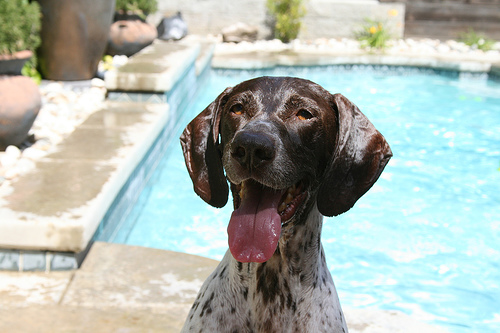

----
Correct answer:  Australian_shepherd
Predicted: 
    Australian_shepherd :  0.453372
    Border_collie :  0.487359
    Icelandic_sheepdog :  0.0256414
    Nova_scotia_duck_tolling_retriever :  0.0324387


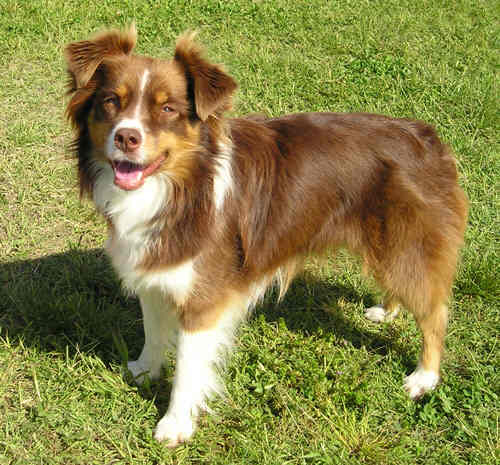

----
Correct answer:  Curly-coated_retriever
Predicted: 
    American_water_spaniel :  0.246617
    Boykin_spaniel :  0.0989918
    Cocker_spaniel :  0.0267539
    Curly-coated_retriever :  0.216452
    Poodle :  0.280033
    Portuguese_water_dog :  0.125256


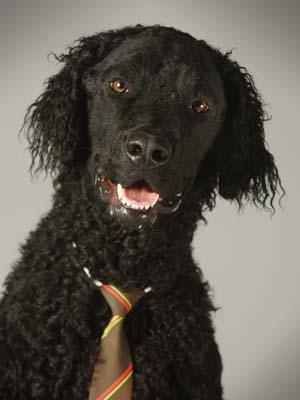

----
Correct answer:  Pembroke_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.787003
    Pembroke_welsh_corgi :  0.212866


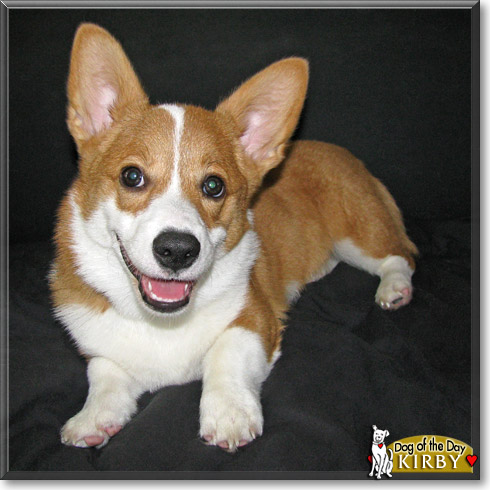

----
Correct answer:  Cardigan_welsh_corgi
Predicted: 
    Cardigan_welsh_corgi :  0.025477
    Icelandic_sheepdog :  0.967465


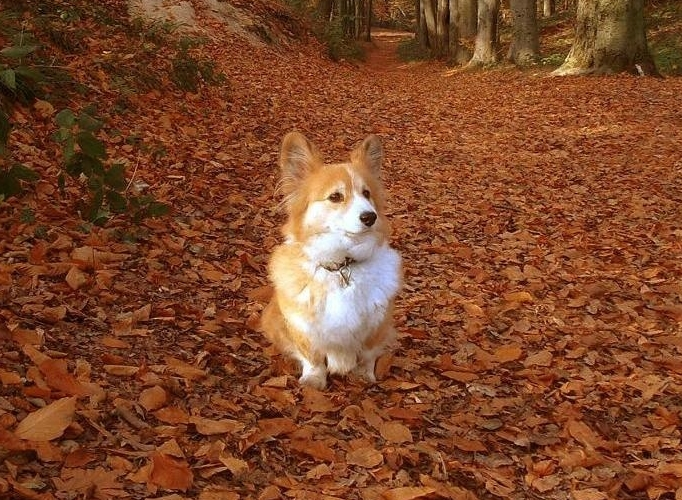

----
Correct answer:  Beagle
Predicted: 
    American_foxhound :  0.0619526
    Basset_hound :  0.815285
    Beagle :  0.112742


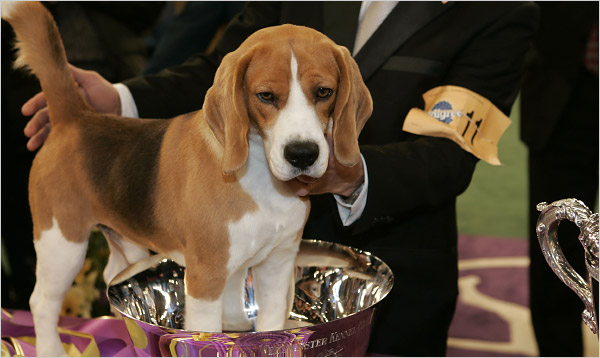

----
Correct answer:  German_shorthaired_pointer
Predicted: 
    Chesapeake_bay_retriever :  0.232637
    German_shorthaired_pointer :  0.166337
    German_wirehaired_pointer :  0.0101796
    Labrador_retriever :  0.0581308
    Plott :  0.0736623
    Pointer :  0.445332


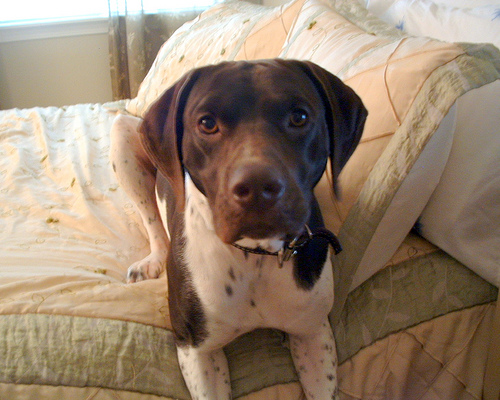

----
Correct answer:  English_toy_spaniel
Predicted: 
    Cavalier_king_charles_spaniel :  0.98792
    English_toy_spaniel :  0.0119013


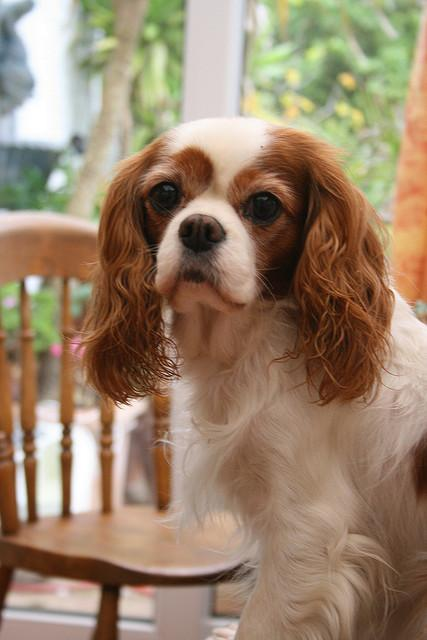

----
Correct answer:  Kerry_blue_terrier
Predicted: 
    Black_russian_terrier :  0.484315
    Kerry_blue_terrier :  0.138162
    Portuguese_water_dog :  0.370336


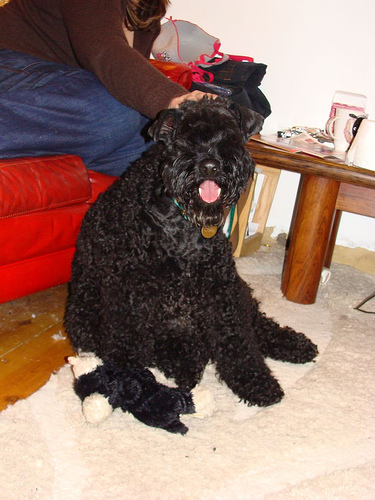

----
Correct answer:  English_cocker_spaniel
Predicted: 
    Cocker_spaniel :  0.887354
    English_cocker_spaniel :  0.112514


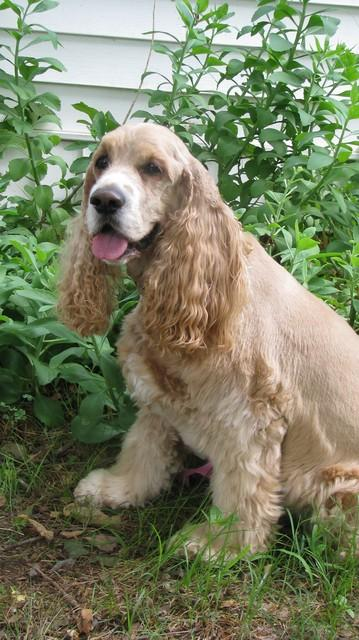

----
Correct answer:  Smooth_fox_terrier
Predicted: 
    Italian_greyhound :  0.963111
    Parson_russell_terrier :  0.0335158


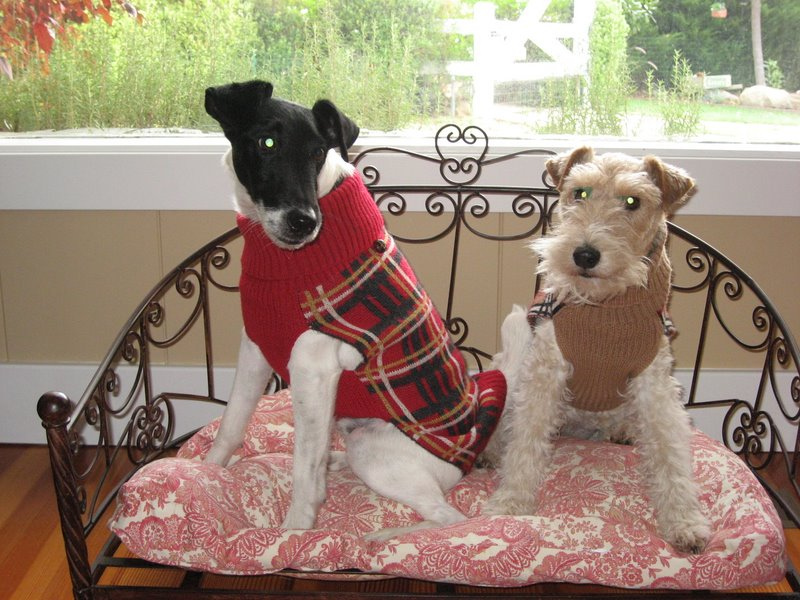

----
Correct answer:  Bearded_collie
Predicted: 
    Bearded_collie :  0.310758
    Havanese :  0.181745
    Lhasa_apso :  0.174098
    Lowchen :  0.330831


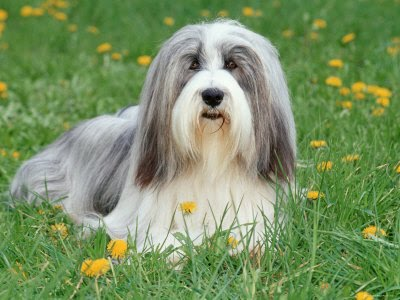

----
Correct answer:  Bluetick_coonhound
Predicted: 
    Pointer :  0.984538


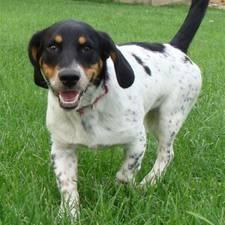

----
Correct answer:  Mastiff
Predicted: 
    Bullmastiff :  0.386241
    Cane_corso :  0.464592
    Mastiff :  0.144873


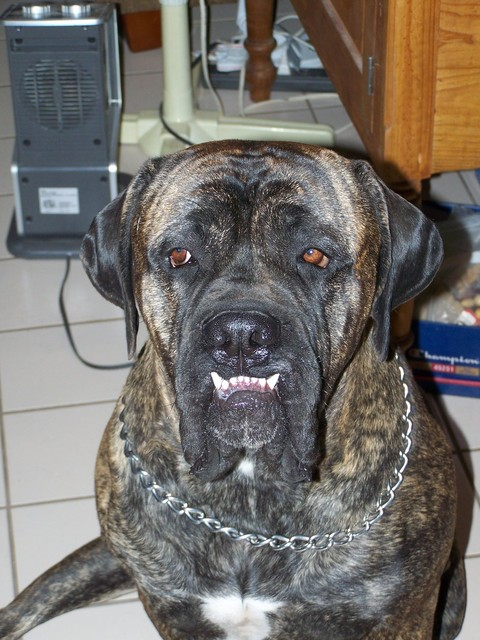

----
Correct answer:  Australian_terrier
Predicted: 
    Australian_terrier :  0.165973
    Norfolk_terrier :  0.037908
    Norwich_terrier :  0.793895


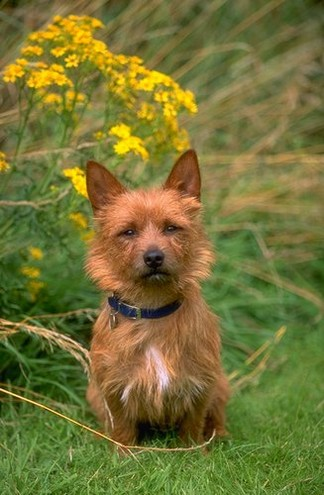

----
Correct answer:  Clumber_spaniel
Predicted: 
    Brittany :  0.132613
    Clumber_spaniel :  0.0476489
    Irish_red_and_white_setter :  0.590353
    Petit_basset_griffon_vendeen :  0.0108919
    Welsh_springer_spaniel :  0.204566


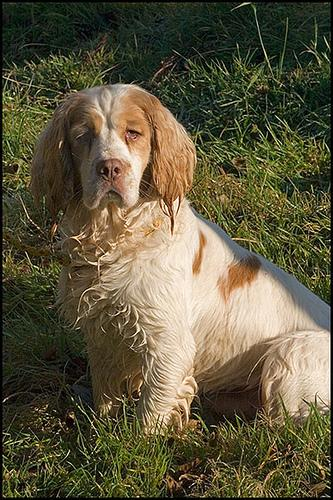

----
Correct answer:  Australian_shepherd
Predicted: 
    Australian_shepherd :  0.193618
    Border_collie :  0.122026
    Nova_scotia_duck_tolling_retriever :  0.67901


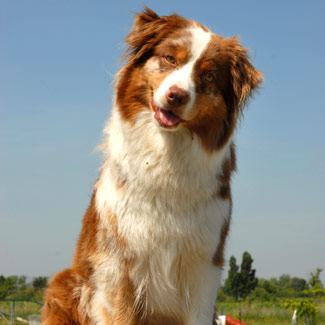

----
Correct answer:  English_cocker_spaniel
Predicted: 
    Boykin_spaniel :  0.0205166
    Cocker_spaniel :  0.772062
    English_cocker_spaniel :  0.205748


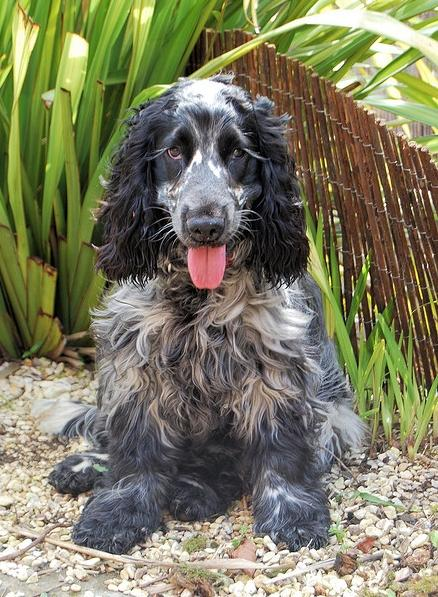

----
Correct answer:  Italian_greyhound
Predicted: 
    Dachshund :  0.0132465
    German_pinscher :  0.912365
    Pharaoh_hound :  0.059906


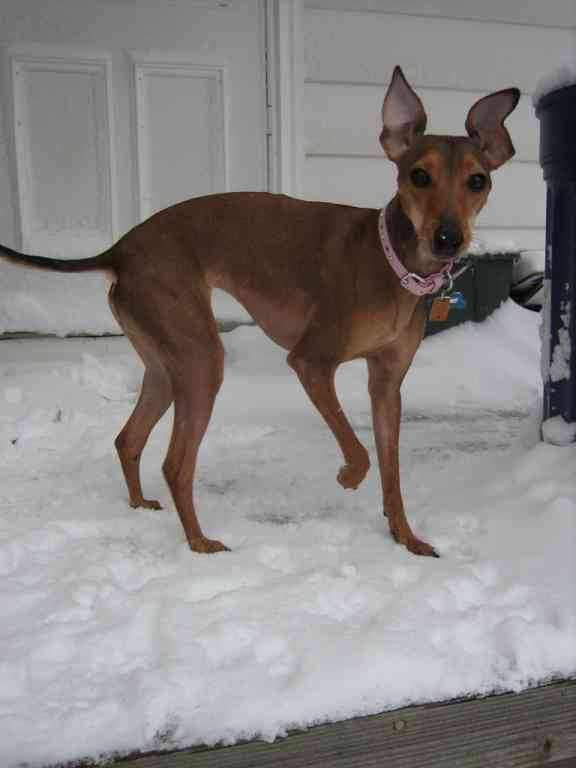

----
Correct answer:  German_shorthaired_pointer
Predicted: 
    Pointer :  0.998598


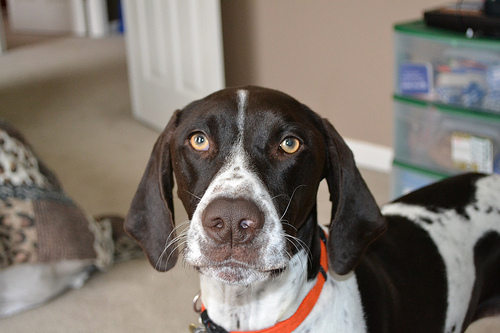

----
Correct answer:  Norwegian_buhund
Predicted: 
    Norwegian_lundehund :  0.988841


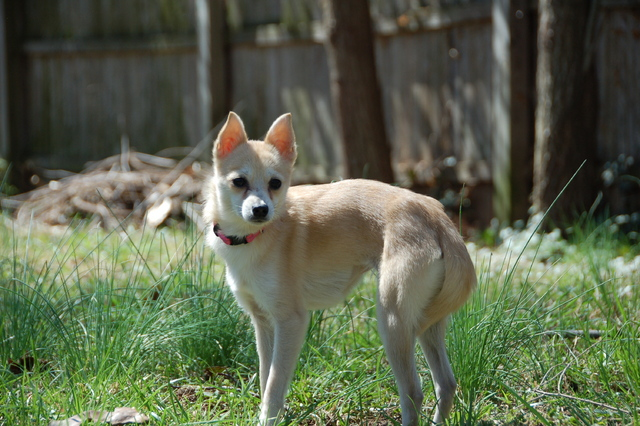

----
Correct answer:  Great_dane
Predicted: 
    Cane_corso :  0.538491
    Great_dane :  0.04465
    Greyhound :  0.411696


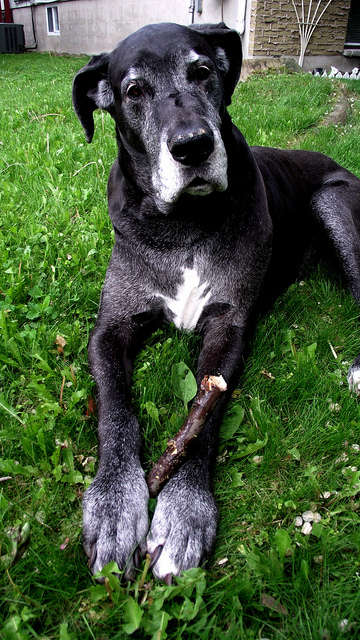

----
Correct answer:  Brittany
Predicted: 
    Irish_red_and_white_setter :  0.0308921
    Welsh_springer_spaniel :  0.968324


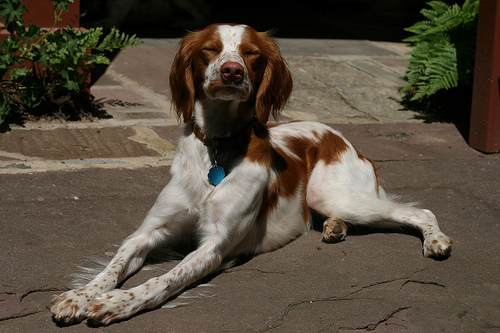

----
Correct answer:  Great_pyrenees
Predicted: 
    Canaan_dog :  0.0134677
    Golden_retriever :  0.695864
    Great_pyrenees :  0.233869
    Kuvasz :  0.0397007


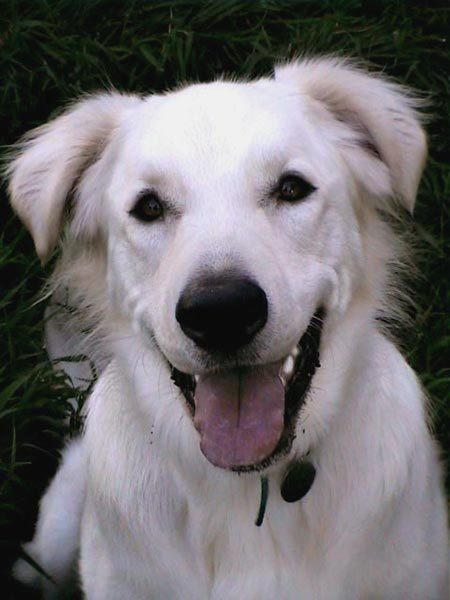

----
Correct answer:  Manchester_terrier
Predicted: 
    Doberman_pinscher :  0.438898
    German_pinscher :  0.330907
    Manchester_terrier :  0.230085


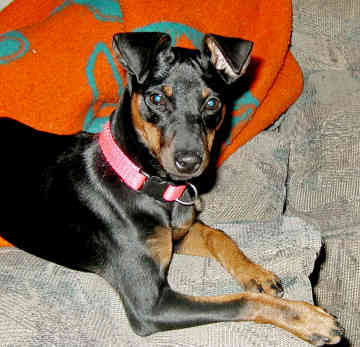

In [28]:
from IPython.display import Image, display

wrong = np.where(np.array(top_model_predictions)!=np.argmax(test_targets, axis=1))

def display_prediction(index):
    print("Predicted: ")
    for i in range(top_model_probabilities[index].shape[1]):
        if top_model_probabilities[index][0][i]>0.01:
            print("   ", dog_names[i], ": ", top_model_probabilities[index][0][i])
            
for wrong_index in wrong[0]:
    print('----')
    print("Correct answer: ", dog_names[np.argmax(test_targets, axis=1)[wrong_index]])
    display_prediction(wrong_index)
    display(Image(filename=test_files[wrong_index]))